In [2]:
#################################################################################################################
# About the Data (source: https://www.kaggle.com/code/threnjen/dataset-cleanup-how-the-train-test-sets-were-made)
#################################################################################################################

## Use 5 look-up datasets from the Bureau of Transportation Statistics:

# T3_AIR_CARRIER_SUMMARY_AIRPORT_ACTIVITY.csv
# B43_AIRCRAFT_INVENTORY.csv
# AIRPORT_COORDINATES.csv
# CARRIER_DECODE.csv
# P10_EMPLOYEES.csv


## Use 2 look-up datasets from the National Centers for Environmental Information:

# Airport_Weather.csv
# Airport_list.csv


In [1]:
import pandas as pd
import numpy as np
import time
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, cross_validate

import warnings
warnings.filterwarnings('ignore')

from autoviz import AutoViz_Class

Imported v0.1.905. Please call AutoViz in this sequence:
    AV = AutoViz_Class()
    %matplotlib inline
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)


In [2]:
#################################################################################################################
# Exploratory Data Analysis
#################################################################################################################

# 1. Load a month of Flight Reporting data from ONTIME_REPORTING_10.csv to explore
df = pd.read_csv('../raw_data/ONTIME_REPORTING_10.csv')
df.shape


print(df.info())
print(df.head(10))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 636014 entries, 0 to 636013
Data columns (total 33 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   MONTH                636014 non-null  int64  
 1   DAY_OF_MONTH         636014 non-null  int64  
 2   DAY_OF_WEEK          636014 non-null  int64  
 3   OP_UNIQUE_CARRIER    636014 non-null  object 
 4   TAIL_NUM             635620 non-null  object 
 5   OP_CARRIER_FL_NUM    636014 non-null  int64  
 6   ORIGIN_AIRPORT_ID    636014 non-null  int64  
 7   ORIGIN               636014 non-null  object 
 8   ORIGIN_CITY_NAME     636014 non-null  object 
 9   DEST_AIRPORT_ID      636014 non-null  int64  
 10  DEST                 636014 non-null  object 
 11  DEST_CITY_NAME       636014 non-null  object 
 12  CRS_DEP_TIME         636014 non-null  int64  
 13  DEP_TIME             631100 non-null  float64
 14  DEP_DELAY_NEW        631100 non-null  float64
 15  DEP_DEL15        

In [3]:
#################################################################################################################
# Load all look-up data sets to determine merge strategy
#################################################################################################################

#################################################################################################################
# 2. Information on passenger activity for airports and airlines
passengers = pd.read_csv('../raw_data/T3_AIR_CARRIER_SUMMARY_AIRPORT_ACTIVITY_2019.csv')

print("\nPassenger activity for Airport and Airlines...... ")
# print(passengers.head(10))
print(passengers.info())
print("Missing Values: ", passengers.isna().sum())
#################################################################################################################

# 3. Information about specific tail numbers for age of aircraft and how many passengers it can seat
aircraft = pd.read_csv("../raw_data/B43_AIRCRAFT_INVENTORY.csv",encoding='latin1')

print("\nManufacture year and passenger capacity for aircraft by unique aircraft tail number..... ")
aircraft.drop_duplicates(subset='TAIL_NUM', inplace=True)
# print(aircraft.head(10))
print(aircraft.info())
print("Missing Values: ", aircraft.isna().sum())

#################################################################################################################

# 4. Information on location of airports
coords = pd.read_csv('../raw_data/AIRPORT_COORDINATES.csv')

print("\nAirport Locations (lat/long).....")
coords.drop_duplicates(subset='ORIGIN_AIRPORT_ID', inplace=True)
# print(coords.head(10))
print(coords.info())
print("Missing Values: ", coords.isna().sum())

#################################################################################################################

# 5. Information on names of carriers for better EDA usage
names = pd.read_csv("../raw_data/CARRIER_DECODE.csv")

print("\nCarrier names.....")
names.drop_duplicates(inplace=True)
names.drop_duplicates(subset=['OP_UNIQUE_CARRIER'], inplace=True)
# print(names.head(10))
print(names.info())
print("Missing Values: ", names.isna().sum())

#################################################################################################################

# 6. Information on employee statistics for carriers
employees = pd.read_csv('../raw_data/P10_EMPLOYEES.csv')

print("\nEmployee stats to determine flight attendents and ground service employees per passenger and per carrier")
#employees = employees[['OP_UNIQUE_CARRIER', 
#                      'PILOTS_COPILOTS', 'OTHER_FLT_PERS',        
#                      'GENERAL_MANAGE', 'STATISTICAL', 'OTHER',  
#                      'PASS_GEN_SVC_ADMIN', 'PASSENGER_HANDLING', 'CARGO_HANDLING', 'TRAINEES_INTRUCTOR', 'TRAFFIC_SOLICITERS', 
#                      'MAINTENANCE', 'ARCFT_TRAF_HANDLING_GRP1', 'GEN_ARCFT_TRAF_HANDLING', 
#                      'AIRCRAFT_CONTROL',  
#                      'TRANSPORT_RELATED', 
#                      'TOTAL',           
#                      ]]
employees = employees[['OP_UNIQUE_CARRIER', 'PASS_GEN_SVC_ADMIN', 'PASSENGER_HANDLING']]
employees = employees.groupby('OP_UNIQUE_CARRIER').sum().reset_index()

# Create aggregate features
#employees['FLIGHT_OPERATIONS'] = (
#    employees['PILOTS_COPILOTS'] +
#    employees['OTHER_FLT_PERS'] +
#    employees['PASSENGER_HANDLING']
#)

#employees['GROUND_SERVICES'] = (
#    employees['PASS_GEN_SVC_ADMIN'] +
#    employees['CARGO_HANDLING'] +
#    employees['TRAINEES_INTRUCTOR'] +
#    employees['TRAFFIC_SOLICITERS']
#)

#employees['MAINTENANCE_AND_HANDLING'] = (
#    employees['MAINTENANCE'] +
#    employees['ARCFT_TRAF_HANDLING_GRP1'] +
#    employees['GEN_ARCFT_TRAF_HANDLING'] +
#    employees['AIRCRAFT_CONTROL']
#)

#employees['ADMINISTRATIVE'] = (
#    employees['GENERAL_MANAGE'] +
#    employees['STATISTICAL'] +
#    employees['OTHER']
#)

#employees['TRANSPORT_RELATED'] = employees['TRANSPORT_RELATED']


# Create ratio columns
# employees['FLIGHT_PERSONNEL_RATIO'] = employees['TOTAL_FLIGHT_PERSONNEL'] / employees['TOTAL']
# employees['GROUND_SERVICE_RATIO'] = employees['TOTAL_GROUND_SERVICE_EMPLOYEES'] / employees['TOTAL']
# employees['MAINTENANCE_AIRCRAFT_HANDLING_RATIO'] = employees['TOTAL_MAINTENANCE_AIRCRAFT_HANDLING'] / employees['TOTAL']
# employees['ADMIN_MANAGEMENT_RATIO'] = employees['TOTAL_ADMIN_MANAGEMENT'] / employees['TOTAL']
# employees['TRANSPORT_RELATED_RATIO'] = employees['TOTAL_TRANSPORT_RELATED'] / employees['TOTAL']

# employees = employees.drop(['PILOTS_COPILOTS', 'OTHER_FLT_PERS', 
#                'PASS_GEN_SVC_ADMIN', 'PASSENGER_HANDLING', 'CARGO_HANDLING', 'TRAINEES_INTRUCTOR', 'TRAFFIC_SOLICITERS',
#                'MAINTENANCE', 'ARCFT_TRAF_HANDLING_GRP1', 'GEN_ARCFT_TRAF_HANDLING',
#                'AIRCRAFT_CONTROL','TRANSPORT_RELATED', 'GENERAL_MANAGE', 'STATISTICAL', 'OTHER'
#               ], axis=1)

# print(employees.head(10))
print(employees.info())
print("Missing Values: ", employees.isna().sum())


#################################################################################################################

# 7. Information on airport weather in 2019 for top 90% of airport cities
# To use snowfall, ground snow, precipitation, wind speed, and temperature as features in our data set
weather_report = pd.read_csv('../raw_data/airport_weather_2019.csv')

print("\nWeather report for top 90% of airports")
# print(weather_report.head(10))
print(weather_report.info())
print("Missing Values: ", weather_report.isna().sum())

# Drop columns with missing values
#weather_report = weather_report.dropna(axis=1)
#print("Missing Values after cleaning: ", weather_report.isna().sum())

#################################################################################################################

# 8. Information set of the airports and their city names to match up with the weather dataset
# Our list of cities and airports including the airport display name so that we can connect with our main df
cities = pd.read_csv('../raw_data/airports_list.csv')

print("\nAirports and City names to match up with weather dataset")
# print(cities.head(10))
print("Missing Values: ", cities.isna().sum())

#################################################################################################################



Passenger activity for Airport and Airlines...... 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27252 entries, 0 to 27251
Data columns (total 6 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   OP_UNIQUE_CARRIER       27252 non-null  object 
 1   CARRIER_NAME            27252 non-null  object 
 2   ORIGIN_AIRPORT_ID       27252 non-null  int64  
 3   SERVICE_CLASS           27252 non-null  object 
 4   REV_ACRFT_DEP_PERF_510  27251 non-null  float64
 5   REV_PAX_ENP_110         25587 non-null  float64
dtypes: float64(2), int64(1), object(3)
memory usage: 1.2+ MB
None
Missing Values:  OP_UNIQUE_CARRIER            0
CARRIER_NAME                 0
ORIGIN_AIRPORT_ID            0
SERVICE_CLASS                0
REV_ACRFT_DEP_PERF_510       1
REV_PAX_ENP_110           1665
dtype: int64

Manufacture year and passenger capacity for aircraft by unique aircraft tail number..... 
<class 'pandas.core.frame.DataFrame'>
Inde

In [4]:
#################################################################################################################
# Merge weather report with city names
#################################################################################################################
weather_merge = pd.merge(cities, weather_report, how='left', on='NAME')
# weather_merge

# Get just the important metrics from the weather report (date, precipitation, snow, temp, wind)
weather = weather_merge[['DATE', 'PRCP', 'SNOW', 'SNWD', 'TMAX', 'AWND', 'ORIGIN_AIRPORT_ID']]

# Drop any rows where no weather was recorded
weather.drop(weather.loc[weather['ORIGIN_AIRPORT_ID'].isna()].index, axis=0, inplace=True)

# Look for null values in temperature
weather.loc[weather['TMAX'].isna()]

# Impute mean in nan rows for temp and wind
weather['TMAX'].fillna(round(weather.groupby('ORIGIN_AIRPORT_ID')['TMAX'].transform('mean'), 1), inplace=True)
weather['AWND'].fillna(round(weather.groupby('ORIGIN_AIRPORT_ID')['AWND'].transform('mean'), 1), inplace=True)
weather.fillna(0, inplace=True)

# Cast data types to datetime so we can get the month and day of month to match up with main df
weather['DATE'] = pd.to_datetime(weather['DATE'], format='mixed')
weather['MONTH'] = pd.DatetimeIndex(weather['DATE']).month
weather['DAY_OF_MONTH'] = pd.DatetimeIndex(weather['DATE']).day
weather

,DATE,PRCP,SNOW,SNWD,TMAX,AWND,ORIGIN_AIRPORT_ID,MONTH,DAY_OF_MONTH
0,2019-01-01,0.00,0.0,0.0,45.0,4.70,12992,1,1
1,2019-01-02,0.39,0.0,0.0,39.0,2.01,12992,1,2
2,2019-01-03,0.44,0.0,0.0,41.0,6.26,12992,1,3
3,2019-01-04,0.13,0.0,0.0,47.0,2.01,12992,1,4
4,2019-01-05,0.00,0.0,0.0,62.0,1.79,12992,1,5
...,...,...,...,...,...,...,...,...,...
35020,2019-12-27,0.00,0.0,0.0,35.0,5.82,10713,12,27
35021,2019-12-28,0.00,0.0,0.0,39.0,2.24,10713,12,28
35022,2019-12-29,0.04,0.1,0.0,32.0,6.26,10713,12,29
35023,2019-12-30,0.00,0.0,0.0,34.0,2.46,10713,12,30


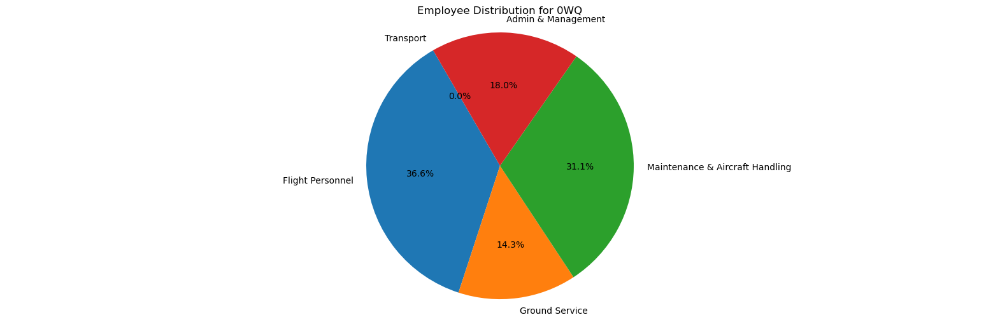

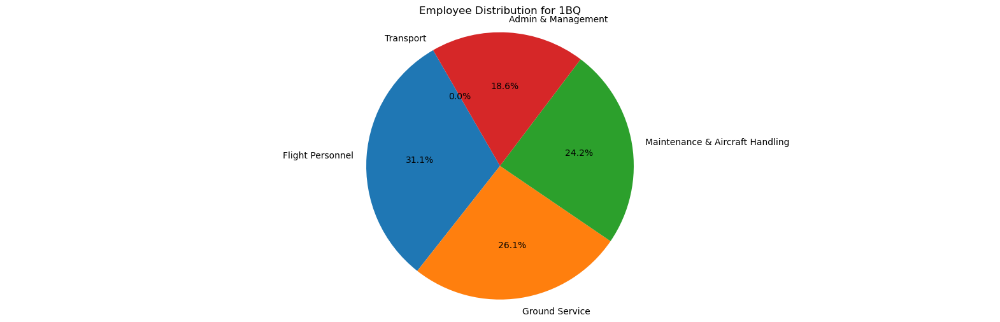

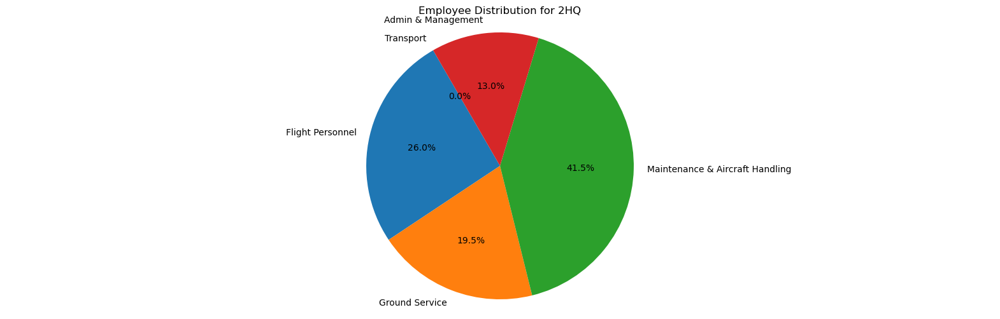

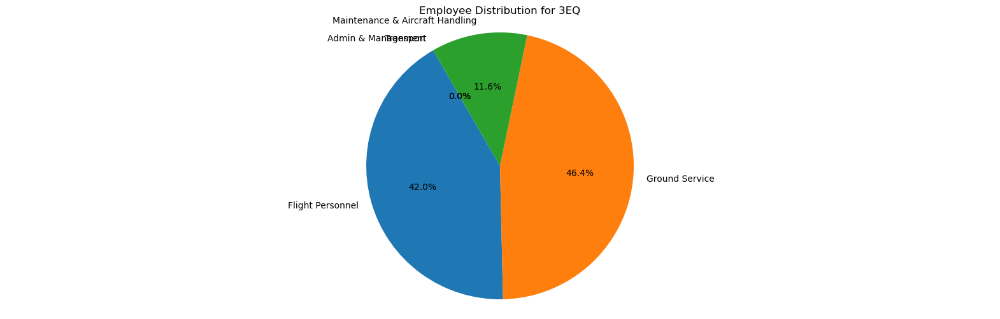

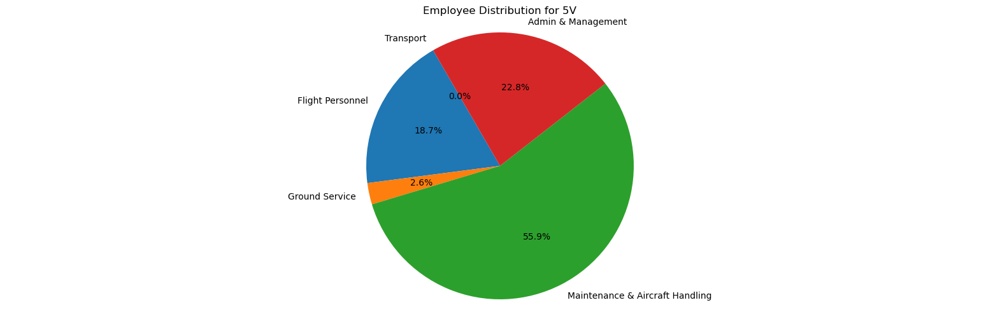

...

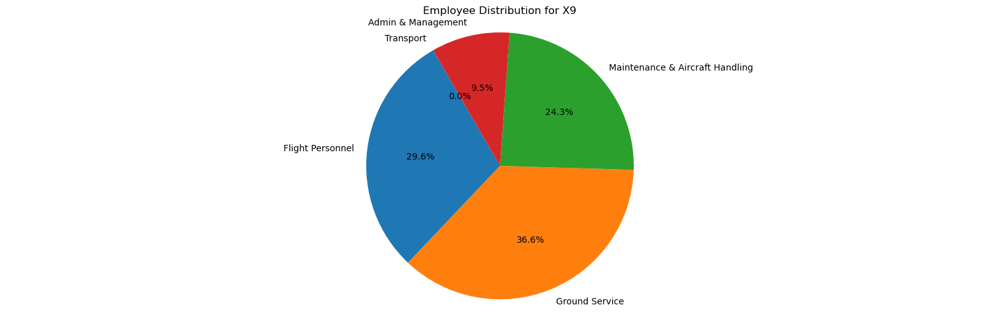

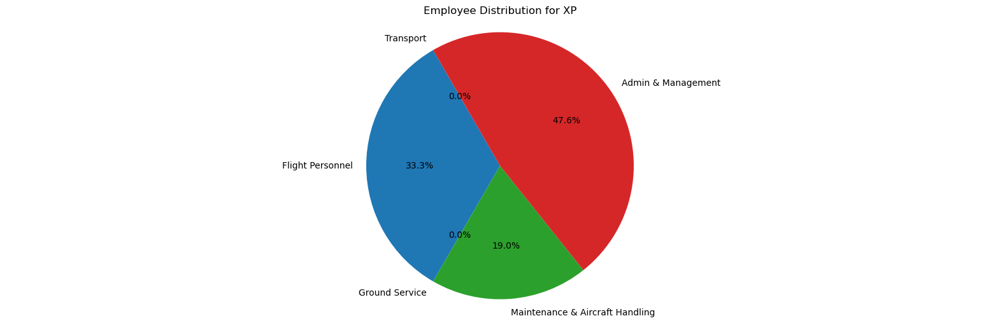

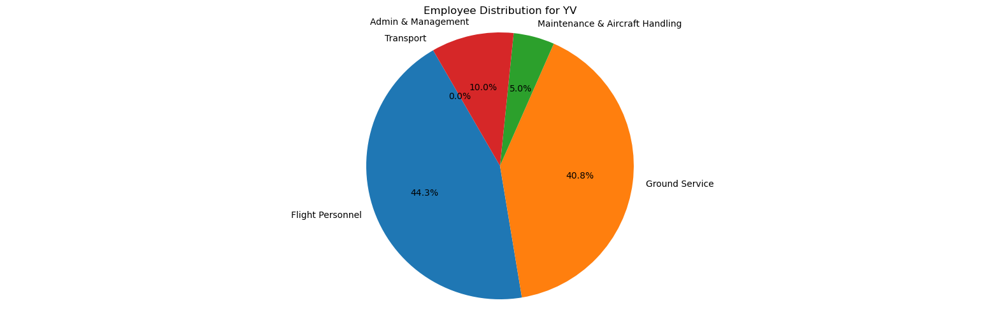

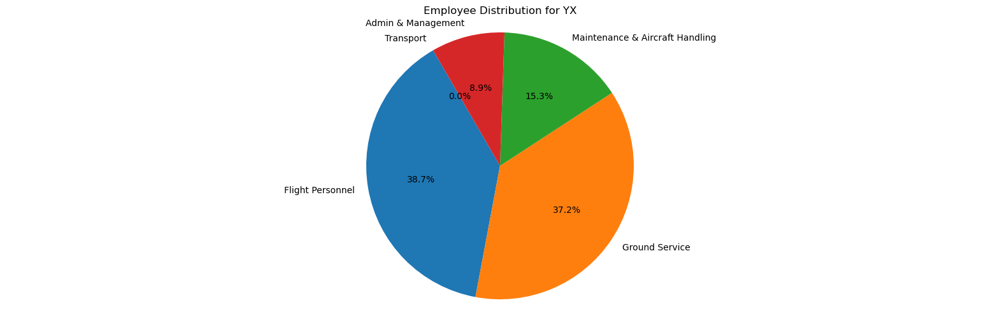

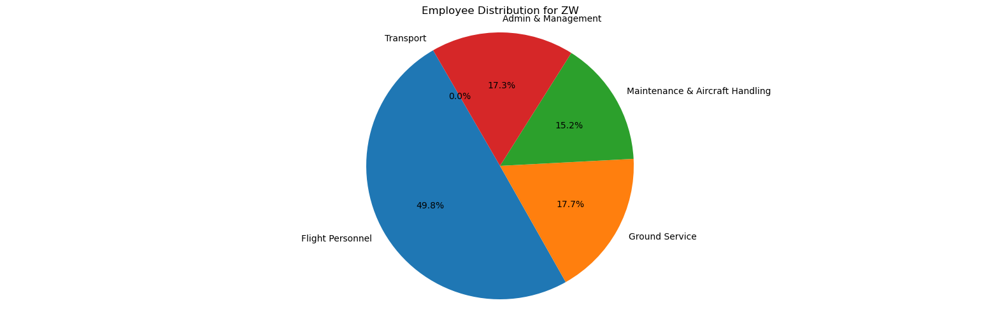

In [70]:
#################################################################################################################
# NOT USED: On employees merged dataframes, explore employee distributions per carrier
#################################################################################################################
# Create a pie chart for each carrier
carriers = employees['OP_UNIQUE_CARRIER'].unique()
for carrier in carriers:
    # Filter data for the current carrier
    carrier_data = employees[employees['OP_UNIQUE_CARRIER'] == carrier]
    
    # Calculate average ratios for the carrier
    avg_ratios = carrier_data[['FLIGHT_PERSONNEL_RATIO', 
                               'GROUND_SERVICE_RATIO', 
                               'MAINTENANCE_AIRCRAFT_HANDLING_RATIO', 
                               'ADMIN_MANAGEMENT_RATIO',
                               'TRANSPORT_RELATED_RATIO' # Neglible 
                              ]].mean()
    
    # Create labels for the pie chart
    labels = ['Flight Personnel', 'Ground Service', 'Maintenance & Aircraft Handling', 'Admin & Management', 'Transport']
    
    # Create the pie chart
    plt.figure(figsize=(20, 6))
    plt.pie(avg_ratios, labels=labels, autopct='%1.1f%%', startangle=120)
    plt.title(f'Employee Distribution for {carrier}')
    plt.axis('equal')
    
    # Show the plot
    plt.show()

In [5]:
#################################################################################################################
# Create categorical variables for departure and arrival delays
#################################################################################################################
def categorize_delay(delay):
    if delay <= 15:
        return 'On-time'
    elif 16 <= delay <= 30:
        return 'Short delay'
    elif 31 <= delay <= 60:
        return 'Medium delay'
    else:
        return 'Long delay'
 


    
#################################################################################################################
# Combine categories to create a single multi-class target variable
#################################################################################################################
def combine_delay_categories(dep_cat, arr_cat):
    if dep_cat == 'On-time' and arr_cat == 'On-time':
        return 'Class 1: On-time departure and arrival'
    elif dep_cat == 'On-time' and arr_cat != 'On-time':
        return 'Class 2: On-time departure, delayed arrival'
    elif dep_cat != 'On-time' and arr_cat == 'On-time':
        return 'Class 3: Delayed departure, on-time arrival'
    else:
        return 'Class 4: Both departure and arrival delayed'

#################################################################################################################
# Class mapping to convert the string labels to numeric labels 
#################################################################################################################
class_mapping = {
    'Class 1: On-time departure and arrival': 0,
    'Class 2: On-time departure, delayed arrival': 1,
    'Class 3: Delayed departure, on-time arrival': 2,
    'Class 4: Both departure and arrival delayed': 3
}


#################################################################################################################
# Combine categories with elapsed_time_difference to create a single multi-class target variable
#################################################################################################################
def classify_overall_delay(dep_delay_cat, arr_delay_cat, elapsed_diff):
    if dep_delay_cat == 'On-time' and arr_delay_cat == 'On-time' and elapsed_diff <= 15:
        return 'Class 1: On-time'
    elif dep_delay_cat == 'On-time' and (arr_delay_cat != 'On-time' or elapsed_diff > 15):
        return 'Class 2: On-time departure, delayed arrival'
    elif dep_delay_cat != 'On-time' and arr_delay_cat == 'On-time' and elapsed_diff <= 15:
        return 'Class 3: Delayed departure, on-time arrival'
    else:
        return 'Class 4: Both departure and arrival delayed'

In [6]:
#################################################################################################################
# Cleaning function for feature engineering, merges and clean-up for each month of On Time flight reporting data
#################################################################################################################
def month_cleanup(monthly_data, aircraft, coords, names, weather, passengers, employees):
    
    '''
    Function which performs features engineering, data merges and cleanup using one month of On-Time data 
    from Bureau of Transportation Services
    
    Parameters:
    monthly_data: month of on-time data as downloaded from BTS
    aircraft: Aircraft inventory data from BTS
    coords: Airport coordinates data from BTS
    names: Carrier names based on carrier code from BTS
    weather: Daily weather reported at airports from National Center for Environmental Information
    passengers: Yearly passenger information for carriers and airports from BTS
    employees: Employee statistics for carriers from BTS
    
    returns: cleaned month of On-Time reporting
    '''
    
    # start the timer so we can track how long the cleaning function takes
    start = time.time()
    
    # drop rows with no departure time, tail number, or were cancelled
    print("Dropping NaNs from Dep Time, Tail Num. Dropping Cancellations.")
    monthly_data.drop(monthly_data.loc[monthly_data['DEP_TIME'].isna()].index, axis=0, inplace=True)
    monthly_data.drop(monthly_data.loc[monthly_data['TAIL_NUM'].isna()].index, axis=0, inplace=True)
    monthly_data.drop(monthly_data.loc[monthly_data['CANCELLED']==1].index, axis=0, inplace=True)
    
    # List flight segment number for daily flight segments by tracking tail number
    print("Adding Flight Number Sequence - SEGMENT_NUMBER")
    monthly_data["SEGMENT_NUMBER"] = monthly_data.groupby(["TAIL_NUM", 'DAY_OF_MONTH'])["DEP_TIME"].rank("dense", ascending=True)
    
    # Listing the number of concurrent flights at the airport in the time block 
    print("Adding Concurrent Flights - CONCURRENT_FLIGHTS")
    monthly_data['CONCURRENT_FLIGHTS'] = monthly_data.groupby(['ORIGIN_AIRPORT_ID','DAY_OF_MONTH', 'DEP_TIME_BLK'])['OP_UNIQUE_CARRIER'].transform("count")
    
    # Merge to get NUMBER_OF_SEATS
    print("Applying seat counts to flights - NUMBER_OF_SEATS")   
    # Merge aircraft info with main frame on tail number - get NUMBER_OF_SEATS 
    monthly_data = pd.merge(monthly_data, aircraft, how="left", on='TAIL_NUM')
    # Fill missing aircraft info with means
    monthly_data['NUMBER_OF_SEATS'].fillna((monthly_data['NUMBER_OF_SEATS'].mean()), inplace=True)
    # simplify data type of number of seats to reduce memory usage
    monthly_data['NUMBER_OF_SEATS'] = monthly_data['NUMBER_OF_SEATS'].astype('int16')
    
    
     # Merge to get proper carrier name
    print("Applying Carrier Names - CARRIER_NAME")  
    monthly_data = pd.merge(monthly_data, names, how='left', on=['OP_UNIQUE_CARRIER'])
    
    # Feature Engineering - AIRPORT_FLIGHTS_MONTH, AIRLINE_FLIGHTS_MONTH, AIRLINE_AIRPORT_FLIGHTS_MONTH
    # Add monthly flight statistics for carrier and airport
    print("Adding flight statistics for carrier and airport - AIRPORT_FLIGHTS_MONTH, AIRLINE_FLIGHTS_MONTH, AIRLINE_AIRPORT_FLIGHTS_MONTH")
    monthly_data['AIRPORT_FLIGHTS_MONTH'] = monthly_data.groupby(['ORIGIN_AIRPORT_ID'])['ORIGIN_CITY_NAME'].transform('count')
    monthly_data['AIRLINE_FLIGHTS_MONTH'] = monthly_data.groupby(['OP_UNIQUE_CARRIER'])['ORIGIN_CITY_NAME'].transform('count')
    monthly_data['AIRLINE_AIRPORT_FLIGHTS_MONTH'] = monthly_data.groupby(['OP_UNIQUE_CARRIER', 'ORIGIN_AIRPORT_ID'])['ORIGIN_CITY_NAME'].transform('count')
    
    
    # Feature Engineering - AVG_MONTHLY_PASS_AIRPORT, AVG_MONTHLY_PASS_AIRLINE
    # Add monthly passenger statistics for carrier and airport
    print("Adding passenger statistics for carrier and airport - AVG_MONTHLY_PASS_AIRPORT, AVG_MONTHLY_PASS_AIRLINE")
    monthly_airport_passengers = pd.DataFrame(passengers.groupby(['ORIGIN_AIRPORT_ID'])['REV_PAX_ENP_110'].sum())
    monthly_data = pd.merge(monthly_data, monthly_airport_passengers, how='left', on=['ORIGIN_AIRPORT_ID'])
    monthly_data['AVG_MONTHLY_PASS_AIRPORT'] = (monthly_data['REV_PAX_ENP_110']/12).astype('int64')
    monthly_airline_passengers = pd.DataFrame(passengers.groupby(['OP_UNIQUE_CARRIER'])['REV_PAX_ENP_110'].sum())
    monthly_data = pd.merge(monthly_data, monthly_airline_passengers, how='left', on=['OP_UNIQUE_CARRIER'])
    monthly_data['AVG_MONTHLY_PASS_AIRLINE'] = (monthly_data['REV_PAX_ENP_110_y']/12).astype('int64')
    
    # Add employee stats then feature engineer FLT_ATTENDANTS_PER_PASS, GROUND_SERV_PER_PASS
    print("Adding employee statistics for carrier - FLT_ATTENDANTS_PER_PASS, GROUND_SERV_PER_PASS")
    monthly_data = pd.merge(monthly_data, employees, how='left', on=['OP_UNIQUE_CARRIER'])
    monthly_data['FLT_ATTENDANTS_PER_PASS'] = monthly_data['PASSENGER_HANDLING']/monthly_data['REV_PAX_ENP_110_y']
    monthly_data['GROUND_SERV_PER_PASS'] = monthly_data['PASS_GEN_SVC_ADMIN']/monthly_data['REV_PAX_ENP_110_y']
    
    # Feature Engineering - PLANE AGE
    # Calculate age of plane
    print("Calculate Fleet Age - PLANE_AGE")
    monthly_data['MANUFACTURE_YEAR'].fillna((monthly_data['MANUFACTURE_YEAR'].mean()), inplace=True)
    monthly_data['PLANE_AGE'] = 2019 - monthly_data['MANUFACTURE_YEAR']

    # Merge to get airport coordinates
    print("Adding airport coordinates - LATITUDE, LONGITUDE, DEPARTING_AIRPORT")
    monthly_data = pd.merge(monthly_data, coords, how='left', on=['ORIGIN_AIRPORT_ID'])
    monthly_data['LATITUDE'] = round(monthly_data['LATITUDE'], 3)
    monthly_data['LONGITUDE'] = round(monthly_data['LONGITUDE'], 3)
    
    # Feature Engineering - PREVIOUS AIRPORT
    # Get previous airport for tail number
    print("Adding airports - PREVIOUS_AIRPORT")
    segment_temp = monthly_data[['DAY_OF_MONTH', 'TAIL_NUM', 'DISPLAY_AIRPORT_NAME', 'SEGMENT_NUMBER']]
    monthly_data = pd.merge_asof(monthly_data.sort_values('SEGMENT_NUMBER'), segment_temp.sort_values('SEGMENT_NUMBER'), on='SEGMENT_NUMBER', by=['DAY_OF_MONTH', 'TAIL_NUM'], allow_exact_matches=False)
    monthly_data['DISPLAY_AIRPORT_NAME_y'].fillna('NONE', inplace=True)
    monthly_data.rename(columns={"DISPLAY_AIRPORT_NAME_y": "PREVIOUS_AIRPORT", "DISPLAY_AIRPORT_NAME_x": "DEPARTING_AIRPORT"}, inplace=True)  
    
    # Cleaning: drop airports below the 10th percentile
    print("Dropping bottom 10% of airports")
    monthly_data.drop(monthly_data.loc[monthly_data['AIRPORT_FLIGHTS_MONTH'] < 1100].index, axis=0, inplace=True)
    
    
    # Merge weather data
    print("Adding daily weather data - PRCP, SNOW, SNWD, SMAX, TMIN, AWND")
    monthly_data = pd.merge(monthly_data, weather, how='inner', on=['ORIGIN_AIRPORT_ID', 'MONTH', 'DAY_OF_MONTH'])
    
    # Add new feature elapsed time difference - how much longer (+ve) or shorter(-ve) the flight took compared to what was initially planned
    # Positive Values: Indicates that the flight took longer than schedule
    # Negative Values:  Indicates that the flight was completed in less time than planned
    monthly_data['CRS_ELAPSED_TIME'].fillna(monthly_data['CRS_ELAPSED_TIME'].median(), inplace=True)
    monthly_data['ACTUAL_ELAPSED_TIME'].fillna(monthly_data['ACTUAL_ELAPSED_TIME'].median(), inplace=True)
    monthly_data['DISTANCE'].fillna(monthly_data['DISTANCE'].median(), inplace=True)
    monthly_data['ELAPSED_TIME_DIFF'] = monthly_data['ACTUAL_ELAPSED_TIME'] - monthly_data['CRS_ELAPSED_TIME']
    
    # Add new category features to monthly data for departure and arrival delays
    monthly_data['ARR_TIME'].fillna(monthly_data['ARR_TIME'].median(), inplace=True)
    monthly_data['DEP_TIME'].fillna(monthly_data['DEP_TIME'].median(), inplace=True)
    monthly_data['CRS_ARR_TIME'].fillna(monthly_data['CRS_ARR_TIME'].median(), inplace=True)
    monthly_data['CRS_DEP_TIME'].fillna(monthly_data['CRS_DEP_TIME'].median(), inplace=True)
    # Delay in departure time for a flight
    # Positive Values: Indicates a departure delay 
    # Negative Values: Indicates an early departure
    # Zero Values:  Indicates that the flight departed exactly at the scheduled time
    monthly_data['DEP_DELAY'] = monthly_data['DEP_TIME'] - monthly_data['CRS_DEP_TIME']
    
    # Delay in arrival time for a flight
    # Positive Values: Indicates an arrival delay
    # Negative Values: Indicates an early arrival
    # Zero Values: Indicates that the flight arrived exactly at the scheduled time
    monthly_data['ARR_DELAY'] = monthly_data['ARR_TIME'] - monthly_data['CRS_ARR_TIME']
    
    
    monthly_data['DEP_DELAY_NEW'].fillna(monthly_data['DEP_DELAY_NEW'].median(), inplace=True)
    monthly_data['ARR_DELAY_NEW'].fillna(monthly_data['ARR_DELAY_NEW'].median(), inplace=True)
    monthly_data['DEP_DELAY_CAT'] = monthly_data['DEP_DELAY_NEW'].apply(categorize_delay)
    monthly_data['ARR_DELAY_CAT'] = monthly_data['ARR_DELAY_NEW'].apply(categorize_delay)
    
    # Add new feature creating a single multi-class target variable
    monthly_data['DELAY_CLASS'] = monthly_data.apply(lambda row: combine_delay_categories(row['DEP_DELAY_CAT'], row['ARR_DELAY_CAT']), axis=1)
    # monthly_data['DELAY_CLASS'] = monthly_data.apply(lambda row: classify_overall_delay(row['DEP_DELAY_CAT'], row['ARR_DELAY_CAT'], row['ELAPSED_TIME_DIFF']), axis=1)
    monthly_data['DELAY_CLASS_NUMERIC'] = monthly_data['DELAY_CLASS'].map(class_mapping)
    
    
    # drop columns that we won't use
    print("Clean up unneeded columns")
    monthly_data.drop(columns = ['ORIGIN',  'DEST', 'DEP_DEL15', 
                       'CANCELLED', 'CANCELLATION_CODE', 
                       'CRS_ELAPSED_TIME', 'ACTUAL_ELAPSED_TIME',
                       # 'DISTANCE',
                       # 'DEP_DELAY_NEW', 'ARR_DELAY_NEW', 
                       'ARR_TIME', 'CRS_ARR_TIME',
                       'DEP_TIME', 'CRS_DEP_TIME',             
                       'CARRIER_DELAY', 'WEATHER_DELAY', 'NAS_DELAY', 'SECURITY_DELAY', 'LATE_AIRCRAFT_DELAY',
                       'Unnamed: 32',
                       'DEST_AIRPORT_ID', 'DEST_CITY_NAME',  'OP_CARRIER_FL_NUM',  'OP_UNIQUE_CARRIER',
                       'AIRLINE_ID', 'DATE', 'DAY_OF_MONTH', 'TAIL_NUM', 
                       'ORIGIN_AIRPORT_ID', 'ORIGIN_CITY_NAME',  'PASSENGER_HANDLING', 'REV_PAX_ENP_110_x', 'REV_PAX_ENP_110_y', 
                       'PASS_GEN_SVC_ADMIN', 'MANUFACTURE_YEAR',
                        ],
                        axis=1, inplace=True)
    
   
    # Cleaning: specify data types of various fields to reduce memory usage
    print("Cleaning up data types")
    monthly_data['MONTH'] = monthly_data['MONTH'].astype('object')
    monthly_data['DAY_OF_WEEK'] = monthly_data['DAY_OF_WEEK'].astype('object')
    monthly_data['DISTANCE_GROUP'] = monthly_data['DISTANCE_GROUP'].astype('int8')
    monthly_data['SEGMENT_NUMBER'] = monthly_data['SEGMENT_NUMBER'].astype('int8')
    monthly_data['DELAY_CLASS_NUMERIC'] = monthly_data['DELAY_CLASS_NUMERIC'].astype('int8')
    monthly_data['AIRPORT_FLIGHTS_MONTH'] = monthly_data['AIRPORT_FLIGHTS_MONTH'].astype('int64')
    monthly_data['AIRLINE_FLIGHTS_MONTH'] = monthly_data['AIRLINE_FLIGHTS_MONTH'].astype('int64')
    monthly_data['AIRLINE_AIRPORT_FLIGHTS_MONTH'] = monthly_data['AIRLINE_AIRPORT_FLIGHTS_MONTH'].astype('int64')
    monthly_data['PLANE_AGE'] = monthly_data['PLANE_AGE'].astype('int32')
    
    # reset index
    monthly_data.reset_index(inplace=True, drop=True)
    
    # return cleaned file
    return monthly_data
 

In [7]:
##################################################################################################################
# Process all monthly ONTIME_REPORTING files
##################################################################################################################
# Define the list of ONTIME_REPORTING monthly files
month_files = [f'../raw_data/ONTIME_REPORTING_{str(i).zfill(2)}.csv' for i in range(1, 13)]

# Function to process each file
def process_file(file_path, aircraft, coords, names, weather, passengers, employees):
    df = pd.read_csv(file_path)
    cleaned_df = month_cleanup(df, aircraft, coords, names, weather, passengers, employees)
    return cleaned_df

# Dictionary to store each month's DataFrame
monthly_data = {}

# Process each file and store the DataFrame in the dictionary
for file in month_files:
    # Generate month names by extracting month part from filename
    month_name = f'month{file[-6:-4]}' 
    print(f'\nProcessing {month_name}')
    
    # Process the file and get the cleaned DataFrame
    cleaned_df = process_file(file, aircraft, coords, names, weather, passengers, employees)
    
    # Store the cleaned DataFrame in the dictionary with the month name as the key
    monthly_data[month_name] = cleaned_df

    # Optional: Print the value counts if needed
    delay_class_counts = cleaned_df['DELAY_CLASS'].value_counts(normalize=True)
    delay_class_numeric_counts = cleaned_df['DELAY_CLASS_NUMERIC'].value_counts(normalize=True)
    print(f'{month_name} - DELAY_CLASS counts:\n{delay_class_counts}')
    print(f'{month_name} - DELAY_CLASS_NUMERIC counts:\n{delay_class_numeric_counts}')

# Access each month's DataFrame using the dictionary
month01 = monthly_data['month01']
month02 = monthly_data['month02']
month03 = monthly_data['month03']
month04 = monthly_data['month04']
month05 = monthly_data['month05']
month06 = monthly_data['month06']
month07 = monthly_data['month07']
month08 = monthly_data['month08']
month09 = monthly_data['month09']
month10 = monthly_data['month10']
month11 = monthly_data['month11']
month12 = monthly_data['month12']



Processing month01
Dropping NaNs from Dep Time, Tail Num. Dropping Cancellations.
Adding Flight Number Sequence - SEGMENT_NUMBER
Adding Concurrent Flights - CONCURRENT_FLIGHTS
Applying seat counts to flights - NUMBER_OF_SEATS
Applying Carrier Names - CARRIER_NAME
Adding flight statistics for carrier and airport - AIRPORT_FLIGHTS_MONTH, AIRLINE_FLIGHTS_MONTH, AIRLINE_AIRPORT_FLIGHTS_MONTH
Adding passenger statistics for carrier and airport - AVG_MONTHLY_PASS_AIRPORT, AVG_MONTHLY_PASS_AIRLINE
Adding employee statistics for carrier - FLT_ATTENDANTS_PER_PASS, GROUND_SERV_PER_PASS
Calculate Fleet Age - PLANE_AGE
Adding airport coordinates - LATITUDE, LONGITUDE, DEPARTING_AIRPORT
Adding airports - PREVIOUS_AIRPORT
Dropping bottom 10% of airports
Adding daily weather data - PRCP, SNOW, SNWD, SMAX, TMIN, AWND
Clean up unneeded columns
Cleaning up data types
month01 - DELAY_CLASS counts:
DELAY_CLASS
Class 1: On-time departure and arrival         0.786607
Class 4: Both departure and arrival del

Adding employee statistics for carrier - FLT_ATTENDANTS_PER_PASS, GROUND_SERV_PER_PASS
Calculate Fleet Age - PLANE_AGE
Adding airport coordinates - LATITUDE, LONGITUDE, DEPARTING_AIRPORT
Adding airports - PREVIOUS_AIRPORT
Dropping bottom 10% of airports
Adding daily weather data - PRCP, SNOW, SNWD, SMAX, TMIN, AWND
Clean up unneeded columns
Cleaning up data types
month07 - DELAY_CLASS counts:
DELAY_CLASS
Class 1: On-time departure and arrival         0.755018
Class 4: Both departure and arrival delayed    0.168190
Class 3: Delayed departure, on-time arrival    0.038674
Class 2: On-time departure, delayed arrival    0.038119
Name: proportion, dtype: float64
month07 - DELAY_CLASS_NUMERIC counts:
DELAY_CLASS_NUMERIC
0    0.755018
3    0.168190
2    0.038674
1    0.038119
Name: proportion, dtype: float64

Processing month08
Dropping NaNs from Dep Time, Tail Num. Dropping Cancellations.
Adding Flight Number Sequence - SEGMENT_NUMBER
Adding Concurrent Flights - CONCURRENT_FLIGHTS
Applying se


Missing values per column:
 MONTH                            0
DAY_OF_WEEK                      0
DEP_DELAY_NEW                    0
DEP_TIME_BLK                     0
ARR_DELAY_NEW                    0
ARR_TIME_BLK                     0
DISTANCE                         0
DISTANCE_GROUP                   0
SEGMENT_NUMBER                   0
CONCURRENT_FLIGHTS               0
NUMBER_OF_SEATS                  0
CARRIER_NAME                     0
AIRPORT_FLIGHTS_MONTH            0
AIRLINE_FLIGHTS_MONTH            0
AIRLINE_AIRPORT_FLIGHTS_MONTH    0
AVG_MONTHLY_PASS_AIRPORT         0
AVG_MONTHLY_PASS_AIRLINE         0
FLT_ATTENDANTS_PER_PASS          0
GROUND_SERV_PER_PASS             0
PLANE_AGE                        0
DEPARTING_AIRPORT                0
LATITUDE                         0
LONGITUDE                        0
PREVIOUS_AIRPORT                 0
PRCP                             0
SNOW                             0
SNWD                             0
TMAX                      

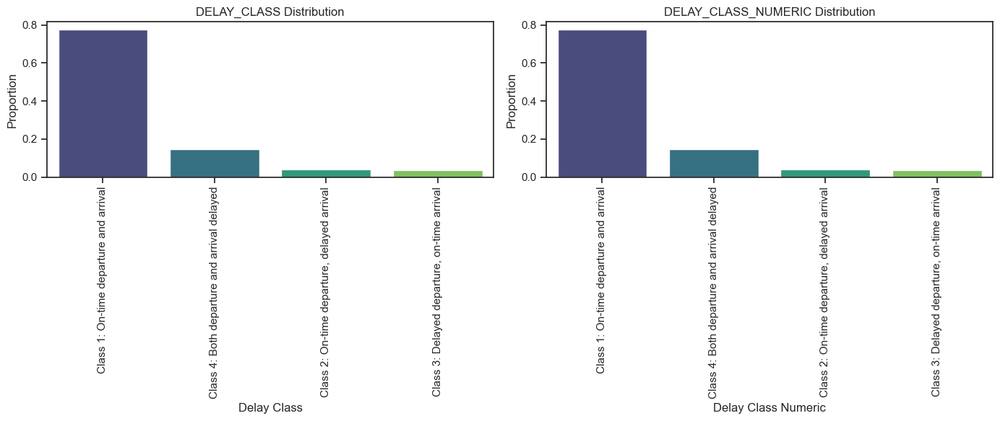

In [8]:
##################################################################################################################################
# Combining all data from across 12 months
##################################################################################################################################
# List of DataFrames to concatenate
months_data = [month01, month02, month03, month04, month05, month06, month07, month08, month09, month10, month11, month12]

# Combine all monthly data into a single DataFrame
all_data = pd.concat(months_data, ignore_index=True)
# all_data.to_csv('./combined_data/train_val.csv', index=False)

###################################################################################################################################
# Check for any missing values 
###################################################################################################################################
# Missing values per column
missing_values_per_column = all_data.isna().sum()
print("\nMissing values per column:\n", missing_values_per_column)

# Missing values per row
missing_values_per_row = all_data.isna().sum(axis=1)
print("\nMissing values per row:\n", missing_values_per_row)

# Total missing values
total_missing = all_data.isna().sum().sum()
print("\nTotal missing values:", total_missing)

# Columns and rows with missing values
columns_with_missing = all_data.columns[all_data.isna().any()].tolist()
rows_with_missing = all_data.index[all_data.isna().any(axis=1)].tolist()
print("\nColumns with missing values:", columns_with_missing)
print("\nRows with missing values:", rows_with_missing)

###################################################################################################################################
# Normalized Value Counts
###################################################################################################################################
# Calculate normalized value counts for delay classes
delay_class_counts = all_data['DELAY_CLASS'].value_counts(normalize=True)
delay_class_numeric_counts = all_data['DELAY_CLASS_NUMERIC'].value_counts(normalize=True)

# Reverse the class_mapping dictionary
reverse_class_mapping = {v: k for k, v in class_mapping.items()}

# Map numeric classes to labels
class_labels = [reverse_class_mapping[num] for num in delay_class_numeric_counts.index]

%matplotlib inline
# Plot distributions
plt.figure(figsize=(14, 6))

# Plot DELAY_CLASS distribution
plt.subplot(1, 2, 1)
sns.barplot(x=delay_class_counts.index, y=delay_class_counts.values, palette='viridis')
plt.title('DELAY_CLASS Distribution')
plt.xlabel('Delay Class')
plt.ylabel('Proportion')
plt.xticks(rotation=90)

# Plot DELAY_CLASS_NUMERIC distribution
plt.subplot(1, 2, 2)
sns.barplot(x=class_labels, y=delay_class_numeric_counts.values, palette='viridis')
plt.title('DELAY_CLASS_NUMERIC Distribution')
plt.xlabel('Delay Class Numeric')
plt.ylabel('Proportion')
plt.xticks(rotation=90)

plt.tight_layout()
plt.show()


train shape: (4542343, 33)
test shape: (1946719, 33)


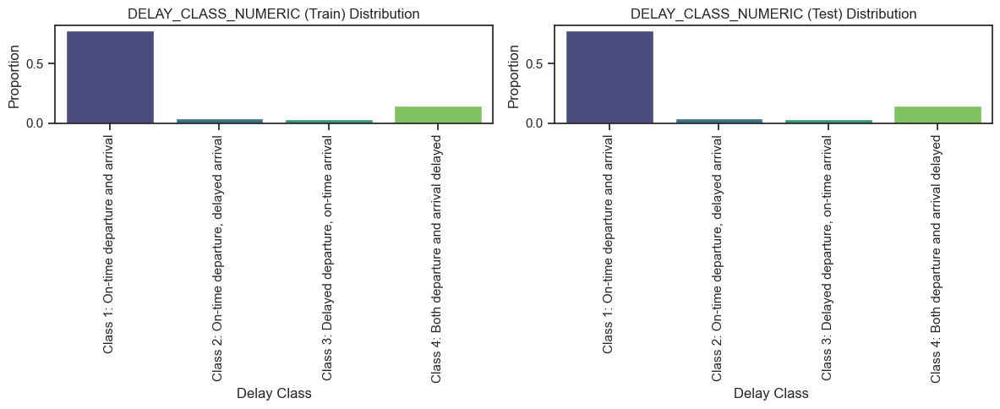

In [9]:
####################################################################################################################
# Create a Train/Test split
####################################################################################################################
# Drop specified category columns and make a copy of all_data
columns_to_drop = ['DEP_DELAY_CAT', 'ARR_DELAY_CAT', 'DELAY_CLASS']

all_data_copy = all_data.copy()
all_data_copy.drop(columns_to_drop, axis = 1, inplace=True)

# X = all_data_copy.drop(columns=['DELAY_CLASS', 'DELAY_CLASS_NUMERIC'])  # Features
# y = all_data_copy['DELAY_CLASS_NUMERIC']  # Target

# Split into training and test sets
train, test = train_test_split(
    all_data_copy, 
    test_size=0.3, 
    random_state=42, 
    stratify=all_data_copy['DELAY_CLASS_NUMERIC']
)

# Print shape of the splits to verify
print(f'train shape: {train.shape}')
print(f'test shape: {test.shape}')

# Calculate the proportions for train and test sets
delay_class_numeric_counts_train = train['DELAY_CLASS_NUMERIC'].value_counts(normalize=True)
delay_class_numeric_counts_test = test['DELAY_CLASS_NUMERIC'].value_counts(normalize=True)

# Reversing the class_mapping dictionary
reverse_class_mapping = {v: k for k, v in class_mapping.items()}

# Create a list of class labels using the reversed mapping, ensuring alignment
train_class_labels = [reverse_class_mapping[num] for num in sorted(delay_class_numeric_counts_train.index)]
test_class_labels = [reverse_class_mapping[num] for num in sorted(delay_class_numeric_counts_test.index)]

# Ensure the order of labels in the plot matches the order of counts
train_counts = [delay_class_numeric_counts_train[num] for num in sorted(delay_class_numeric_counts_train.index)]
test_counts = [delay_class_numeric_counts_test[num] for num in sorted(delay_class_numeric_counts_test.index)]

# Plot DELAY_CLASS_NUMERIC distribution in Train and Test
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
sns.barplot(x=train_class_labels, y=train_counts, palette='viridis')
plt.title('DELAY_CLASS_NUMERIC (Train) Distribution')
plt.xlabel('Delay Class')
plt.ylabel('Proportion')
plt.xticks(rotation=90)

plt.subplot(1, 2, 2)
sns.barplot(x=test_class_labels, y=test_counts, palette='viridis')
plt.title('DELAY_CLASS_NUMERIC (Test) Distribution')
plt.xlabel('Delay Class ')
plt.ylabel('Proportion')
plt.xticks(rotation=90)

plt.tight_layout()
plt.show()


In [10]:
#############################################################################################################################
# Compute and merge historical delay averages based on various categorical groupings
# CARRIER_HISTORICAL, DEP_AIRPORT_HIST, PREV_AIRPORT_HIST, DAY_HISTORICAL, and DEP_BLOCK_HIST

# CARRIER_HISTORICAL = captures the historical average delay rate of each carrier per month
# DEP_AIRPORT_HIST =  captures historical average delay rates for flights departing from specific airports per month
# PREV_AIRPORT_HIST = captures historical average delay rate for the airport from which the aircraft arrived before the current departure
# DAY_HISTORICAL = captures historical average delays associated with each day of the week, adjusted monthly
# DEP_BLOCK_HIST = captures historical average delay rate for different departure time blocks, aggregated by month
#############################################################################################################################
def calculate_and_merge_historical_averages(df, group_by_columns, delay_column, new_column_name):
    """
    Calculates historical averages of delay classes for different categories and merges them back to the original DataFrame.

    Parameters:
    - df (pd.DataFrame): The original DataFrame containing the data.
    - group_by_columns (list): List of columns to group by.
    - delay_column (str): The column name containing delay class numeric values.
    - new_column_name (str): Prefix for naming the new columns with historical averages.

    Returns:
    - pd.DataFrame: The original DataFrame with new columns added for historical averages.
    """
    # Calculate historical averages
    historical_df = (
        df.groupby(group_by_columns)[delay_column]
        .mean()
        .reset_index(name=new_column_name)
    )
    # Merge historical averages back onto the original DataFrame
    df = pd.merge(df, historical_df, how='left', on=group_by_columns)
    return df


###################################################################################################################
# Calculate and merge historical averages for each category on train data
###################################################################################################################
train = calculate_and_merge_historical_averages(
        train, 
        ['CARRIER_NAME', 'MONTH'], 
        'DELAY_CLASS_NUMERIC', 
        'CARRIER_HISTORICAL'
    )

train = calculate_and_merge_historical_averages(
        train, 
        ['DEPARTING_AIRPORT', 'MONTH'], 
        'DELAY_CLASS_NUMERIC', 
        'DEP_AIRPORT_HIST'
    )

train = calculate_and_merge_historical_averages(
        train, 
        ['PREVIOUS_AIRPORT', 'MONTH'], 
        'DELAY_CLASS_NUMERIC', 
        'PREV_AIRPORT_HIST'
    )

train = calculate_and_merge_historical_averages(
        train, 
        ['DAY_OF_WEEK', 'MONTH'], 
        'DELAY_CLASS_NUMERIC', 
        'DAY_HISTORICAL'
    )

train = calculate_and_merge_historical_averages(
        train, 
        ['DEP_TIME_BLK', 'MONTH'], 
        'DELAY_CLASS_NUMERIC', 
        'DEP_BLOCK_HIST'
    )

# Fillna with mean
train['DEP_AIRPORT_HIST'].fillna(train['DEP_AIRPORT_HIST'].mean(), inplace=True)


###################################################################################################################
# Calculate and merge historical averages for each category on test data
###################################################################################################################
test = calculate_and_merge_historical_averages(
        test, 
        ['CARRIER_NAME', 'MONTH'], 
        'DELAY_CLASS_NUMERIC', 
        'CARRIER_HISTORICAL'
    )

test = calculate_and_merge_historical_averages(
        test, 
        ['DEPARTING_AIRPORT', 'MONTH'], 
        'DELAY_CLASS_NUMERIC', 
        'DEP_AIRPORT_HIST'
    )

test = calculate_and_merge_historical_averages(
        test, 
        ['PREVIOUS_AIRPORT', 'MONTH'], 
        'DELAY_CLASS_NUMERIC', 
        'PREV_AIRPORT_HIST'
    )

test = calculate_and_merge_historical_averages(
        test, 
        ['DAY_OF_WEEK', 'MONTH'], 
        'DELAY_CLASS_NUMERIC', 
        'DAY_HISTORICAL'
    )

test = calculate_and_merge_historical_averages(
        test, 
        ['DEP_TIME_BLK', 'MONTH'], 
        'DELAY_CLASS_NUMERIC', 
        'DEP_BLOCK_HIST'
    )

# fillna with mean
test['DEP_AIRPORT_HIST'].fillna(test['DEP_AIRPORT_HIST'].mean(), inplace=True)


In [11]:
print(train.shape)
print(test.shape)
print(train.info())

(4542343, 38)
(1946719, 38)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4542343 entries, 0 to 4542342
Data columns (total 38 columns):
 #   Column                         Dtype  
---  ------                         -----  
 0   MONTH                          object 
 1   DAY_OF_WEEK                    object 
 2   DEP_DELAY_NEW                  float64
 3   DEP_TIME_BLK                   object 
 4   ARR_DELAY_NEW                  float64
 5   ARR_TIME_BLK                   object 
 6   DISTANCE                       float64
 7   DISTANCE_GROUP                 int8   
 8   SEGMENT_NUMBER                 int8   
 9   CONCURRENT_FLIGHTS             int64  
 10  NUMBER_OF_SEATS                int16  
 11  CARRIER_NAME                   object 
 12  AIRPORT_FLIGHTS_MONTH          int64  
 13  AIRLINE_FLIGHTS_MONTH          int64  
 14  AIRLINE_AIRPORT_FLIGHTS_MONTH  int64  
 15  AVG_MONTHLY_PASS_AIRPORT       int64  
 16  AVG_MONTHLY_PASS_AIRLINE       int64  
 17  FLT_ATTENDANTS_PER

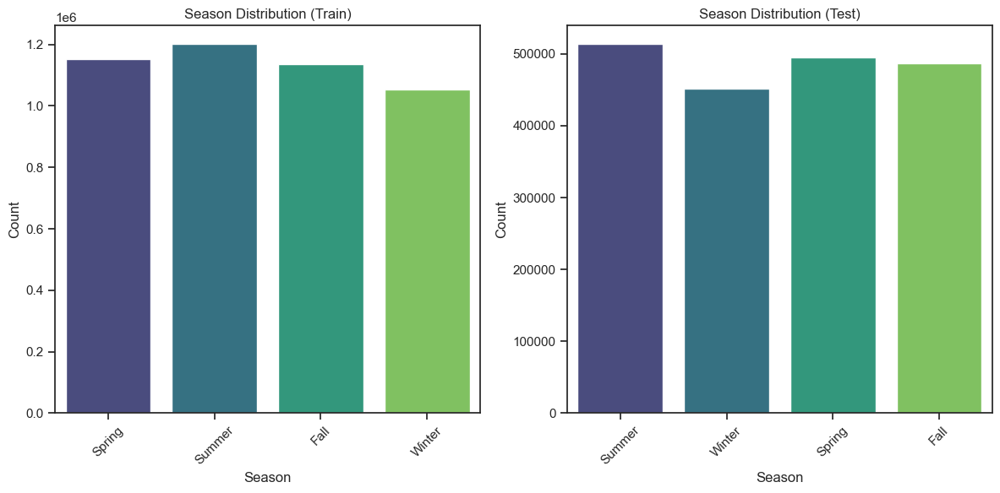

In [12]:
####################################################################################################################
# Month to Season mapping
####################################################################################################################
def add_season_column(df, month_column='MONTH', season_column='SEASON'):
    """
    Adds a season column to the DataFrame based on the month column.

    Parameters:
    - df (pd.DataFrame): The DataFrame containing the month data.
    - month_column (str): The name of the column with month information.
    - season_column (str): The name of the new column to be added for seasons.

    Returns:
    - pd.DataFrame: The DataFrame with the new season column added.
    """
    # Define the mapping of months to seasons
    month_to_season = {
        12: 'Winter', 1: 'Winter', 2: 'Winter',
        3: 'Spring', 4: 'Spring', 5: 'Spring',
        6: 'Summer', 7: 'Summer', 8: 'Summer',
        9: 'Fall', 10: 'Fall', 11: 'Fall'
    }
    
    # Map the month to season and create a new column
    df[season_column] = df[month_column].map(month_to_season)
    
    return df

train = add_season_column(train)     # Add the season column to train
test = add_season_column(test)       # Add the season column to test

# Plot for 'SEASON' distribution in train dataset
plt.figure(figsize=(12, 6))

# Plot the distribution of seasons in the train dataset
plt.subplot(1, 2, 1)
sns.countplot(data=train, x='SEASON', palette='viridis')
plt.title('Season Distribution (Train)')
plt.xlabel('Season')
plt.ylabel('Count')
plt.xticks(rotation=45)

# Plot the distribution of seasons in the test dataset
plt.subplot(1, 2, 2)
sns.countplot(data=test, x='SEASON', palette='viridis')
plt.title('Season Distribution (Test)')
plt.xlabel('Season')
plt.ylabel('Count')
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()


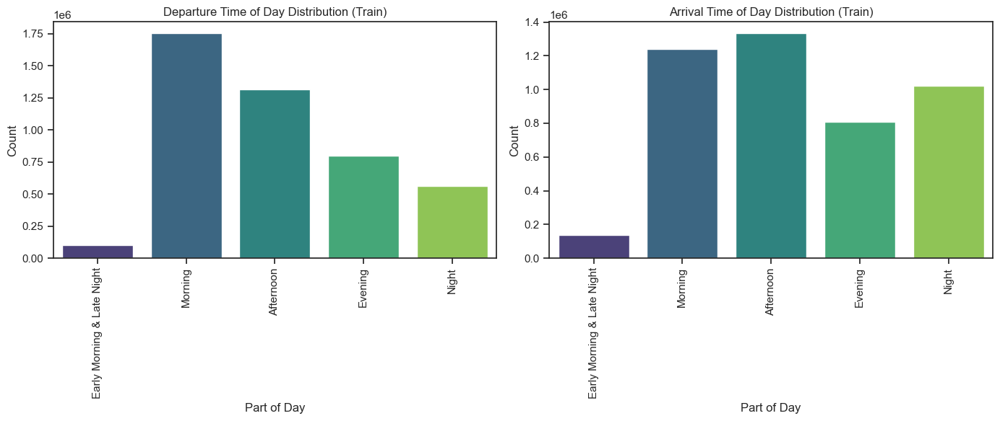

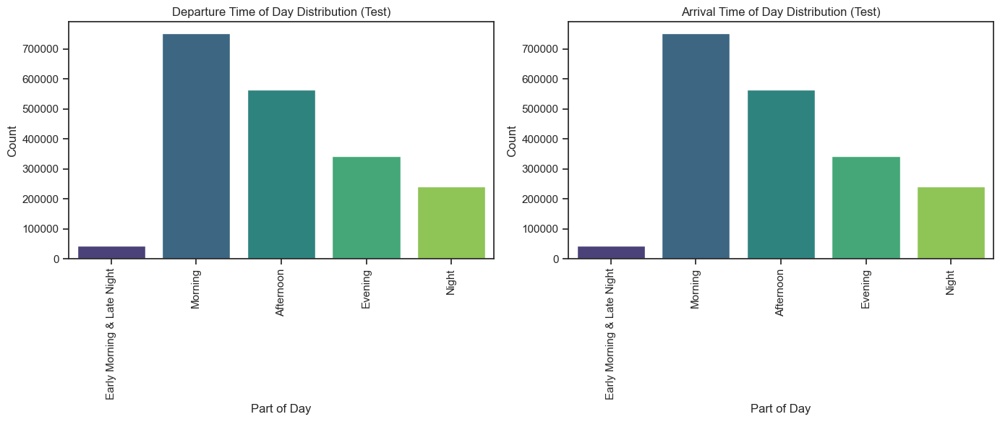

In [13]:
####################################################################################################################
# Mapping to get Time of day from dep_time_blk and arr_time_blk
####################################################################################################################
def map_to_part_of_day(df, time_block_column, part_of_day_column='PART_OF_DAY'):
    """
    Maps time blocks to parts of the day and adds a new column to the DataFrame.

    Parameters:
    - df (pd.DataFrame): The DataFrame containing the time block data.
    - time_block_column (str): The name of the column containing time blocks in the format 'HHMM-HHMM'.
    - part_of_day_column (str): The name of the new column to be added for parts of the day.

    Returns:
    - pd.DataFrame: The DataFrame with an additional column for the part of the day.
    """
    time_blocks_order = [
        'Early Morning & Late Night',  # 0001-0559
        'Morning',                     # 0600-1159
        'Afternoon',                   # 1200-1659
        'Evening',                     # 1700-1959
        'Night'                        # 2000-2359
    ]

    df[part_of_day_column] = pd.cut(
        df[time_block_column].map(lambda x: int(x.split('-')[0])),
        bins=[0, 600, 1200, 1700, 2000, 2400],
        labels=time_blocks_order,
        right=False
    )

    return df


train = map_to_part_of_day(train, 'DEP_TIME_BLK', 'DEP_PART_OF_DAY')
train = map_to_part_of_day(train, 'ARR_TIME_BLK', 'ARR_PART_OF_DAY')
test  = map_to_part_of_day(test, 'DEP_TIME_BLK', 'DEP_PART_OF_DAY')
test  = map_to_part_of_day(test, 'DEP_TIME_BLK', 'ARR_PART_OF_DAY')

plt.figure(figsize=(14, 6))

# Plot for DEP_PART_OF_DAY in train
plt.subplot(1, 2, 1)
sns.countplot(data=train, x='DEP_PART_OF_DAY', palette='viridis')
plt.title('Departure Time of Day Distribution (Train)')
plt.xlabel('Part of Day')
plt.ylabel('Count')
plt.xticks(rotation=90)

# Plot for ARR_PART_OF_DAY in train
plt.subplot(1, 2, 2)
sns.countplot(data=train, x='ARR_PART_OF_DAY', palette='viridis')
plt.title('Arrival Time of Day Distribution (Train)')
plt.xlabel('Part of Day')
plt.ylabel('Count')
plt.xticks(rotation=90)

plt.tight_layout()
plt.show()

# Plot for DEP_PART_OF_DAY in test
plt.figure(figsize=(14, 6))
plt.subplot(1, 2, 1)
sns.countplot(data=test, x='DEP_PART_OF_DAY', palette='viridis')
plt.title('Departure Time of Day Distribution (Test)')
plt.xlabel('Part of Day')
plt.ylabel('Count')
plt.xticks(rotation=90)

# Plot for ARR_PART_OF_DAY in test
plt.subplot(1, 2, 2)
sns.countplot(data=test, x='ARR_PART_OF_DAY', palette='viridis')
plt.title('Arrival Time of Day Distribution (Test)')
plt.xlabel('Part of Day')
plt.ylabel('Count')
plt.xticks(rotation=90)

plt.tight_layout()
plt.show()


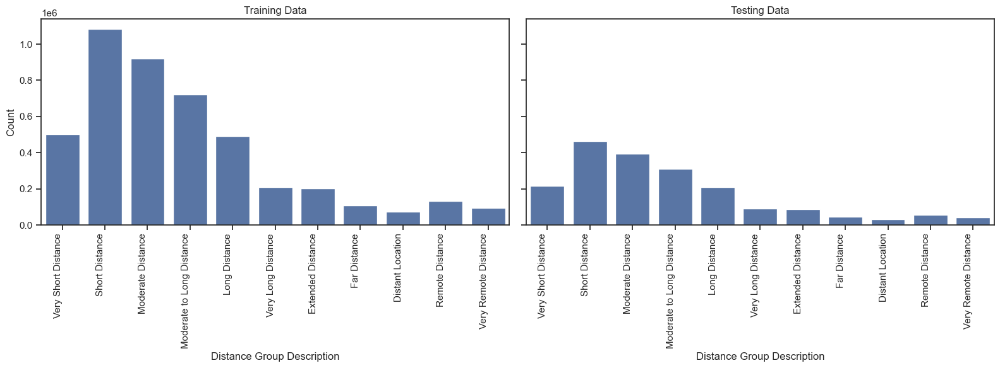

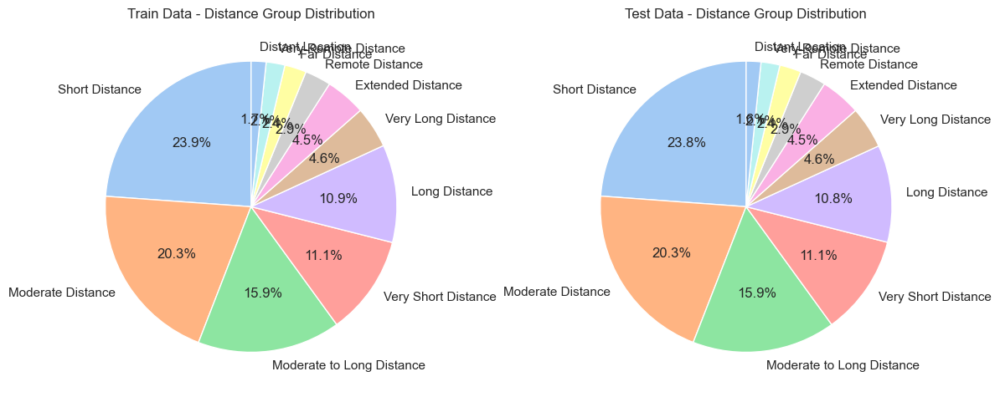

In [14]:
#########################################################################################################################
# Mapping column DISTANCE_GROUP_DESC
#########################################################################################################################
def add_distance_description(df):
    """
    Adds a 'DISTANCE_GROUP_DESC' column to the DataFrame based on the 'DISTANCE_GROUP' column.

    Parameters:
    df (DataFrame): The DataFrame containing a 'DISTANCE_GROUP' column.

    Returns:
    DataFrame: The modified DataFrame with a new 'Distance_Description' column.
    """
    # Define the mapping based on given values (example mapping)
    mapping = {
        1: 'Very Short Distance',
        2: 'Short Distance',
        3: 'Moderate Distance',
        4: 'Moderate to Long Distance',
        5: 'Long Distance',
        6: 'Very Long Distance',
        7: 'Extended Distance',
        8: 'Far Distance',
        9: 'Distant Location',
        10: 'Remote Distance',
        11: 'Very Remote Distance'
    }
    
    # Create a new column 'Distance_Description' using the mapping
    df['DISTANCE_GROUP_DESC'] = df['DISTANCE_GROUP'].map(mapping)
    
    return df

# Apply mapping
train = add_distance_description(train)
test = add_distance_description(test)

### Plot 1: Bar Plot for Train and Test Data

# Set up the figure for side-by-side plots
fig, axes = plt.subplots(1, 2, figsize=(16, 6), sharey=True)

# Bar plot for training data
sns.countplot(data=train, x='DISTANCE_GROUP_DESC', ax=axes[0], order=[
    'Very Short Distance', 'Short Distance', 'Moderate Distance', 
    'Moderate to Long Distance', 'Long Distance', 'Very Long Distance', 
    'Extended Distance', 'Far Distance', 'Distant Location', 
    'Remote Distance', 'Very Remote Distance'
])
axes[0].set_title('Training Data')
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=90, ha='right')
axes[0].set_xlabel('Distance Group Description')
axes[0].set_ylabel('Count')

# Bar plot for testing data
sns.countplot(data=test, x='DISTANCE_GROUP_DESC', ax=axes[1], order=[
    'Very Short Distance', 'Short Distance', 'Moderate Distance', 
    'Moderate to Long Distance', 'Long Distance', 'Very Long Distance', 
    'Extended Distance', 'Far Distance', 'Distant Location', 
    'Remote Distance', 'Very Remote Distance'
])
axes[1].set_title('Testing Data')
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=90, ha='right')
axes[1].set_xlabel('Distance Group Description')
axes[1].set_ylabel('Count')

plt.tight_layout()
plt.show()

### Plot 2: Pie Chart for Train and Test Data

# Train data pie chart
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
train['DISTANCE_GROUP_DESC'].value_counts().plot.pie(autopct='%1.1f%%', startangle=90, colors=sns.color_palette('pastel'))
plt.title('Train Data - Distance Group Distribution')
plt.ylabel('')

# Test data pie chart
plt.subplot(1, 2, 2)
test['DISTANCE_GROUP_DESC'].value_counts().plot.pie(autopct='%1.1f%%', startangle=90, colors=sns.color_palette('pastel'))
plt.title('Test Data - Distance Group Distribution')
plt.ylabel('')

plt.tight_layout()
plt.show()

In [15]:
# For all mapped columns above drop the source of mapping
train.drop(columns=['ARR_TIME_BLK', 'DEP_TIME_BLK', 'DISTANCE_GROUP'], axis=1, inplace=True)
test.drop(columns=['ARR_TIME_BLK', 'DEP_TIME_BLK', 'DISTANCE_GROUP'], axis=1, inplace=True)

print(train.info())
print(test.info())

documentation = """
### Dataset Documentation

#### Overview
- **Train DataFrame Shape:** (4542343, 41)
- **Test DataFrame Shape :** (1946719, 41)
- **Data Types:**
  - `object`: Categorical or string data
  - `float64`: Continuous numerical data
  - `int8`: Small integers
  - `int16`: Medium-sized integers
  - `int32`: Larger integers
  - `int64`: Large integers
  - `category`: Categorical data with ordered or unordered categories

#### Features

1. **MONTH** (`object`)
   - **Description:** Month of the year when the flight occurred (e.g., 'January', 'February').
   - **Values:** 12 months (e.g., 'January', 'February', etc.)

2. **DAY_OF_WEEK** (`object`)
   - **Description:** Day of the week when the flight occurred (e.g., 'Monday', 'Tuesday').
   - **Values:** 7 days of the week (e.g., 'Monday', 'Tuesday', etc.)

3. **DEP_DELAY_NEW** (`float64`)
   - **Description:** Departure delay in minutes, including delays longer than 15 minutes.
   - **Values:** Continuous values (e.g., 0.0, 5.0, 15.0, etc.)

4. **ARR_DELAY_NEW** (`float64`)
   - **Description:** Arrival delay in minutes, including delays longer than 15 minutes.
   - **Values:** Continuous values (e.g., 0.0, 5.0, 15.0, etc.)

5. **DISTANCE** (`float64`)
   - **Description:** Distance of the flight in miles.
   - **Values:** Continuous values (e.g., 500.0, 1200.0, etc.)

6. **DISTANCE_GROUP_DESCRIPTION** (`int8`)
   - **Description:** Categorized distance group.
   -    1: 'Very Short Distance',
   -    2: 'Short Distance',
   -    3: 'Moderate Distance',
   -    4: 'Moderate to Long Distance',
   -    5: 'Long Distance',
   -    6: 'Very Long Distance',
   -    7: 'Extended Distance',
   -    8: 'Far Distance',
   -    9: 'Distant Location',
   -    10: 'Remote Distance',
   -    11: 'Very Remote Distance'
   - **Values:** Categories.

7. **SEGMENT_NUMBER** (`int8`)
   - **Description:** Segment number is assigned to each flight based on its departure time (DEP_TIME) 
       for each combination of TAIL_NUM (aircraft identifier) and DAY_OF_MONTH (specific day). The first flight 
       of the day for a given aircraft will have a segment number of 1, the second will have 2, and so on.
       This is useful for identifying the order in which flights occur on a particular day for each aircraft.
   - **Values:** Integer values.

8. **CONCURRENT_FLIGHTS** (`int64`)
    - **Description:** This contains the number of flights departing from a given airport (ORIGIN_AIRPORT_ID) 
        during a particular day (DAY_OF_MONTH) and departure time block (DEP_TIME_BLK). 
        This value represents the total flights operating concurrently during that specific time window at that airport.
    - **Values:** Integer values.

9. **NUMBER_OF_SEATS** (`int16`)
    - **Description:** Number of seats available on the flight.
    - **Values:** Integer values.

10. **CARRIER_NAME** (`object`)
    - **Description:** Name of the airline carrier (e.g., 'American Airlines', 'Delta').
    - **Values:** Airline names.

11. **AIRPORT_FLIGHTS_MONTH** (`int64`)
    - **Description:** Represents the total number of flights departing from a specific airport (ORIGIN_AIRPORT_ID) during the entire month.
        It gives a count of how many flights took off from each airport, regardless of the airline or other factors, providing an overall flight 
        volume for each airport for the month. This is useful for analyzing airport traffic, identifying busy airports, and studying 
        airport-specific demand over a monthly period.
    - **Values:** Integer values.

12. **AIRLINE_FLIGHTS_MONTH** (`int64`)
    - **Description:** Represents the total number of flights operated by a specific airline (OP_UNIQUE_CARRIER) during the entire month, 
        across all airports. It gives a count of flights for each airline, to analyze how many flights each airline has operated in the month, 
        regardless of origin or destination. This is useful for analyzing airline activity, comparing airline sizes, or determining which airlines 
        have the most operations over a given period.
    - **Values:** Integer values.

13. **AIRLINE_AIRPORT_FLIGHTS_MONTH** (`int64`)
    - **Description:** Represents the number of flights operated by a specific airline (OP_UNIQUE_CARRIER) from a 
        specific airport (ORIGIN_AIRPORT_ID) during the month. It gives a combined count of flights for each airline and airport pair, 
        providing insight into how active each airline is at each airport for the month. This is useful for studying the distribution 
        of flights between airlines and airports, identifying airline dominance at particular airports, and understanding 
        airport-airline relationships over a monthly period.
    - **Values:** Integer values.

14. **AVG_MONTHLY_PASS_AIRPORT** (`int64`)
    - **Description:** Represents the average monthly number of passengers at a specific airport. 
        The monthly_airport_passengers datadrame is created by grouping the passengers data by ORIGIN_AIRPORT_ID and summing the 
        total passengers (REV_PAX_ENP_110) for each airport. This data is merged with monthly_data, adding the total passengers 
        for each airport. The AVG_MONTHLY_PASS_AIRPORT feature is then calculated by dividing the total passengers by 12 to obtain the 
        average monthly passengers per airport.
    - **Values:** Integer values.

15. **AVG_MONTHLY_PASS_AIRLINE** (`int64`)
    - **Description:** Represents the average monthly number of passengers for a specific airline.
        The monthly_airline_passengers dataframe is created by grouping the passengers data by airline (OP_UNIQUE_CARRIER) and summing the
        total passengers for each. This data is merged with monthly_data, and the AVG_MONTHLY_PASS_AIRLINE feature is calculated by dividing the total passengers by 12 to obtain the average monthly passengers per airline
    - **Values:** Integer values.

16. **FLT_ATTENDANTS_PER_PASS** (`float64`)
    - **Description:** Represents employee statistics and is the number of flight attendants per passenger on average.
        Calculated as the ratio of the number of flight attendants involved in passenger handling (PASSENGER_HANDLING) 
        to the number of passengers enplaned (REV_PAX_ENP_110_y).
    - **Values:** Continuous values.

17. **GROUND_SERV_PER_PASS** (`float64`)
    - **Description:** Represents employee statistics and is the number of ground service personnel per passenger on average.
        Calculated as the ratio of ground service and administrative staff (PASS_GEN_SVC_ADMIN) to the number of passengers
        enplaned (REV_PAX_ENP_110_y).
    - **Values:** Continuous values.

18. **PLANE_AGE** (`int32`)
    - **Description:** Age of the plane in years. PLANE_AGE is created by subtracting the MANUFACTURE_YEAR from the 
      current year (2019) which is when the flight delays data-set is coming from.
    - **Values:** Integer values.

19. **DEPARTING_AIRPORT** (`object`)
    - **Description:** Represents the airport name from which the current flight is departing from. 
    - **Values:** Airport name.

20. **LATITUDE** (`float64`)
    - **Description:** Latitude coordinate of the airport.
    - **Values:** Continuous values.

21. **LONGITUDE** (`float64`)
    - **Description:** Longitude coordinate of the airport.
    - **Values:** Continuous values.

22. **PREVIOUS_AIRPORT** (`object`)
    - **Description:** This is the airport where the previous segment for the same TAIL_NUM (aircraft) ended. 
      It's where the aircraft last landed at its previous destination. 
    - **Values:** Airport names.

23. **PRCP** (`float64`)
    - **Description:** Precipitation (in inches) at the airport on the day of the flight.
    - **Values:** Continuous values.

24. **SNOW** (`float64`)
    - **Description:** Snowfall (in inches) at the airport on the day of the flight.
    - **Values:** Continuous values.

25. **SNWD** (`float64`)
    - **Description:** Snow depth (in inches) at the airport on the day of the flight.
    - **Values:** Continuous values.

26. **TMAX** (`float64`)
    - **Description:** Maximum temperature (in degrees Fahrenheit) at the airport on the day of the flight.
    - **Values:** Continuous values.

27. **AWND** (`float64`)
    - **Description:** Average wind speed (in miles per hour) at the airport on the day of the flight.
    - **Values:** Continuous values.

28. **ELAPSED_TIME_DIFF** (`float64`)
    - **Description:** Difference between actual elapsed time and planned elapsed time.
    - **Values:** Continuous values.

29. **DEP_DELAY** (`float64`)
    - **Description:** Delay in departure time for a flight.
    -  Positive Values: Indicates a departure delay. 
    -  Negative Values: Indicates an early departure.
    -  Zero Values:  Indicates that the flight departed exactly at the scheduled time.
    - **Values:** Continuous values.

30. **ARR_DELAY** (`float64`)
    - **Description:** Delay in arrival time for a flight
    -   Positive Values: Indicates an arrival delay.
    -   Negative Values: Indicates an early arrival.
    -   Zero Values: Indicates that the flight arrived exactly at the scheduled time.
    - **Values:** Continuous values.

31. **DELAY_CLASS_NUMERIC** (`int64`)
    - **Description:** Numeric representation of the delay class.
    -   Class 1: On-time departure and arrival: 0.
    -   Class 2: On-time departure, delayed arrival: 1.
    -   Class 3: Delayed departure, on-time arrival: 2.
    -   Class 4: Both departure and arrival delayed: 3.
    - **Values:** Integer categories.

32. **CARRIER_HISTORICAL** (`float64`)
    - **Description:** Historical average delay rates of each carrier per month.
    - **Values:** Continuous values.

33. **DEP_AIRPORT_HIST** (`float64`)
    - **Description:** Historical average delay rates for flights departing from specific airports per month.
    - **Values:** Continuous values.

34. **PREV_AIRPORT_HIST** (`float64`)
    - **Description:**  Historical average delay rate for the airport from which the aircraft arrived before the current departure.
    - **Values:** Continuous values.

35. **DAY_HISTORICAL** (`float64`)
    - **Description:** Historical average delay for the specific day of the week, aggregated by month.
    - **Values:** Continuous values.

36. **DEP_BLOCK_HIST** (`float64`)
    - **Description:** Historical average delay for different departure time blocks, aggregated by month.
    - **Values:** Continuous values.

37. **SEASON** (`object`)
    - **Description:** Season of the year when the flight occurred (e.g., 'Winter', 'Spring').
    -   Month 12: 'Winter', 1: 'Winter', 2: 'Winter'.
    -   Month 3: 'Spring', 4: 'Spring', 5: 'Spring'.
    -   Month 6: 'Summer', 7: 'Summer', 8: 'Summer'.
    -   Month 9: 'Fall', 10: 'Fall', 11: 'Fall'.
    - **Values:** Four seasons ('Winter', 'Spring', 'Summer', 'Fall').

38. **DEP_PART_OF_DAY** (`category`)
    - **Description:** Part of the day when the departure occurred (e.g., 'Early Morning & Late Night', 'Morning').
    -  'Early Morning & Late Night',  # 0001-0559.
    -  'Morning',                     # 0600-1159.
    -  'Afternoon',                   # 1200-1659.
    -  'Evening',                     # 1700-1959.
    -  'Night'                        # 2000-2359.
    - **Values:** Time blocks of the day.

39. **ARR_PART_OF_DAY** (`category`)
    - **Description:** Part of the day when the arrival occurred (e.g., 'Early Morning & Late Night', 'Morning').
    -  'Early Morning & Late Night',  # 0001-0559.
    -  'Morning',                     # 0600-1159.
    -  'Afternoon',                   # 1200-1659.
    -  'Evening',                     # 1700-1959.
    -  'Night'                        # 2000-2359.
    - **Values:** Time blocks of the day.
    
"""

# Write documentation to a text file
with open('../combined_data/dataset_documentation.txt', 'w') as file:
    file.write(documentation)

print("Documentation has been written to 'dataset_documentation.txt'")


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4542343 entries, 0 to 4542342
Data columns (total 39 columns):
 #   Column                         Dtype   
---  ------                         -----   
 0   MONTH                          object  
 1   DAY_OF_WEEK                    object  
 2   DEP_DELAY_NEW                  float64 
 3   ARR_DELAY_NEW                  float64 
 4   DISTANCE                       float64 
 5   SEGMENT_NUMBER                 int8    
 6   CONCURRENT_FLIGHTS             int64   
 7   NUMBER_OF_SEATS                int16   
 8   CARRIER_NAME                   object  
 9   AIRPORT_FLIGHTS_MONTH          int64   
 10  AIRLINE_FLIGHTS_MONTH          int64   
 11  AIRLINE_AIRPORT_FLIGHTS_MONTH  int64   
 12  AVG_MONTHLY_PASS_AIRPORT       int64   
 13  AVG_MONTHLY_PASS_AIRLINE       int64   
 14  FLT_ATTENDANTS_PER_PASS        float64 
 15  GROUND_SERV_PER_PASS           float64 
 16  PLANE_AGE                      int32   
 17  DEPARTING_AIRPORT          

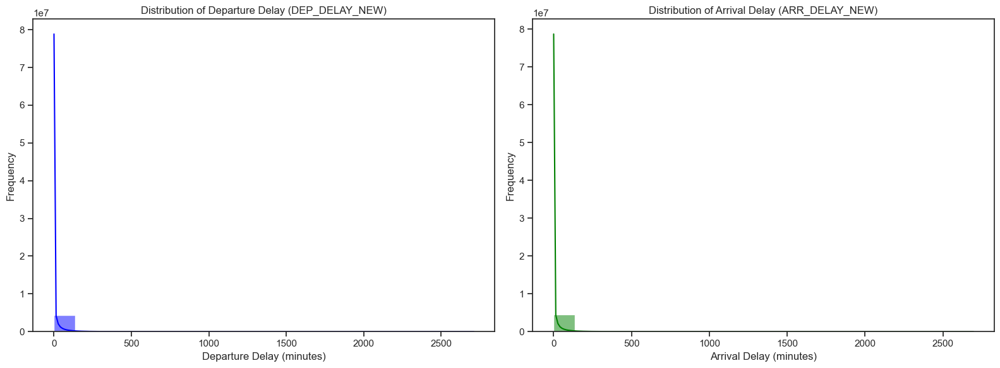

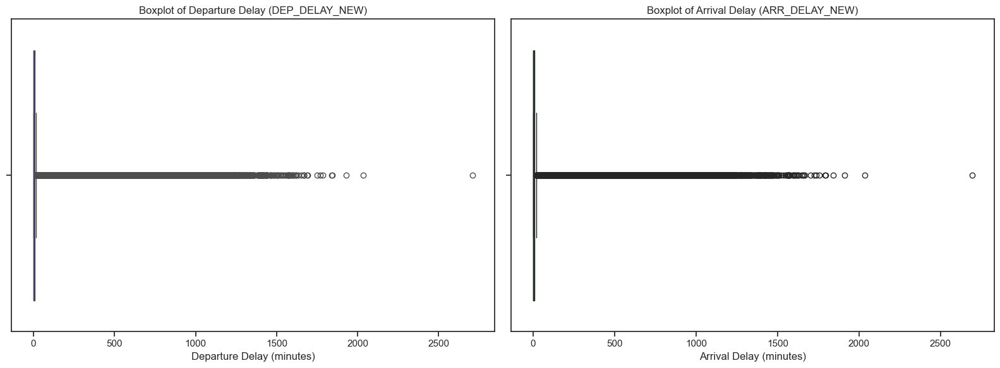

In [20]:
#####################################################################################################################
# Plots to explore distribitions of DEP_DELAY_NEW and ARR_DELAY_NEW in training data
#####################################################################################################################
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Histogram for DEP_DELAY_NEW
sns.histplot(train['DEP_DELAY_NEW'], bins=20, kde=True, ax=axes[0], color='blue')
axes[0].set_title('Distribution of Departure Delay (DEP_DELAY_NEW)')
axes[0].set_xlabel('Departure Delay (minutes)')
axes[0].set_ylabel('Frequency')

# Histogram for ARR_DELAY_NEW
sns.histplot(train['ARR_DELAY_NEW'], bins=20, kde=True, ax=axes[1], color='green')
axes[1].set_title('Distribution of Arrival Delay (ARR_DELAY_NEW)')
axes[1].set_xlabel('Arrival Delay (minutes)')
axes[1].set_ylabel('Frequency')

plt.tight_layout()
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Boxplot for DEP_DELAY_NEW
sns.boxplot(x=train['DEP_DELAY_NEW'], ax=axes[0], color='blue')
axes[0].set_title('Boxplot of Departure Delay (DEP_DELAY_NEW)')
axes[0].set_xlabel('Departure Delay (minutes)')

# Boxplot for ARR_DELAY_NEW
sns.boxplot(x=train['ARR_DELAY_NEW'], ax=axes[1], color='green')
axes[1].set_title('Boxplot of Arrival Delay (ARR_DELAY_NEW)')
axes[1].set_xlabel('Arrival Delay (minutes)')

plt.tight_layout()
plt.show()

In [16]:
#########################################################################################################
# Save train and test files 
#########################################################################################################
train.to_csv('../combined_data/train.csv', index=False)
test.to_csv('../combined_data/test.csv', index=False)

Shape of your Data Set loaded: (4542343, 39)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
  Printing up to 30 columns (max) in each category:
    Numeric Columns : ['DEP_DELAY_NEW', 'ARR_DELAY_NEW', 'DISTANCE', 'GROUND_SERV_PER_PASS', 'LATITUDE', 'LONGITUDE', 'PRCP', 'SNOW', 'SNWD', 'TMAX', 'AWND', 'ELAPSED_TIME_DIFF', 'DEP_DELAY', 'ARR_DELAY', 'CARRIER_HISTORICAL', 'DEP_AIRPORT_HIST', 'PREV_AIRPORT_HIST', 'DAY_HISTORICAL', 'DEP_BLOCK_HIST', 'FLT_ATTENDANTS_PER_PASS']
    Integer-Categorical Columns: ['SEGMENT_NUMBER', 'CONCURRENT_FLIGHTS', 'NUMBER_OF_SEATS', 'AIRPORT_FLIGHTS_MONTH', 'AIRLINE_FLIGHTS_MONTH', 'AIRLINE_AIRPORT_FLIGHTS_MONTH', 'AVG_MONTHLY_PASS_AIRPORT', 'AVG_MONTHLY_PASS_AIRLINE', 'PLANE_AGE']
    String-Categorical Col

,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
MONTH,object,0.000000,0,,,No issue
DAY_OF_WEEK,object,0.000000,0,,,No issue
DEP_DELAY_NEW,float64,0.000000,NA,0.000000,2710.000000,Column has 779893 outliers greater than upper bound (17.50) or lower than lower bound(-10.50). Cap them or remove them.
ARR_DELAY_NEW,float64,0.000000,NA,0.000000,2695.000000,"Column has 720129 outliers greater than upper bound (20.00) or lower than lower bound(-12.00). Cap them or remove them., Column has a high correlation with ['DEP_DELAY_NEW']. Consider dropping one of them."
DISTANCE,float64,0.000000,NA,66.000000,5095.000000,Column has 283339 outliers greater than upper bound (2080.00) or lower than lower bound(-616.00). Cap them or remove them.
SEGMENT_NUMBER,int8,0.000000,0,1.000000,15.000000,Column has 70548 outliers greater than upper bound (7.00) or lower than lower bound(-1.00). Cap them or remove them.
CONCURRENT_FLIGHTS,int64,0.000000,0,1.000000,109.000000,Column has 106949 outliers greater than upper bound (81.00) or lower than lower bound(-31.00). Cap them or remove them.
NUMBER_OF_SEATS,int16,0.000000,0,44.000000,337.000000,Column has 1769 outliers greater than upper bound (295.00) or lower than lower bound(-33.00). Cap them or remove them.
CARRIER_NAME,object,0.000000,0,,,1 rare categories: ['Allegiant Air']. Group them into a single category or drop the categories.
AIRPORT_FLIGHTS_MONTH,int64,0.000000,0,1100.000000,35256.000000,Column has a high correlation with ['CONCURRENT_FLIGHTS']. Consider dropping one of them.


Total Number of Scatter Plots = 210
Could not draw some Distribution Plots 'numpy.int8' object has no attribute 'startswith'


[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to
[nltk_data]    |     /Users/diptia/nltk_data...
[nltk_data]    |   Package cmudict is already up-to-date!
[nltk_data]    | Downloading package gazetteers to
[nltk_data]    |     /Users/diptia/nltk_data...
[nltk_data]    |   Package gazetteers is already up-to-date!
[nltk_data]    | Downloading package genesis to
[nltk_data]    |     /Users/diptia/nltk_data...
[nltk_data]    |   Package genesis is already up-to-date!
[nltk_data]    | Downloading package gutenberg to
[nltk_data]    |     /Users/diptia/nltk_data...
[nltk_data]    |   Package gutenberg is already up-to-date!
[nltk_data]    | Downloading package inaugural to
[nltk_data]    |     /Users/diptia/nltk_data...
[nltk_data]    |   Package inaugural is already up-to-date!
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]    |     /Users/diptia/nltk_data...
[nltk_data]    |   Package movie_reviews is already

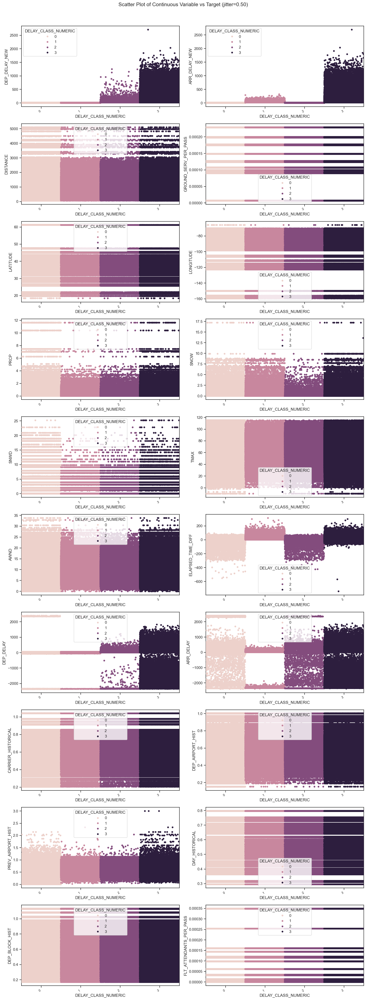

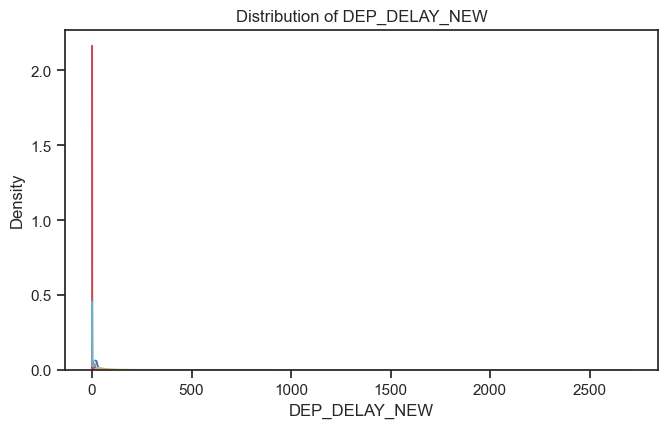

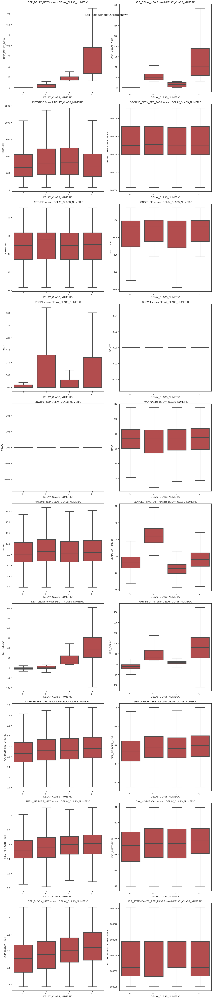

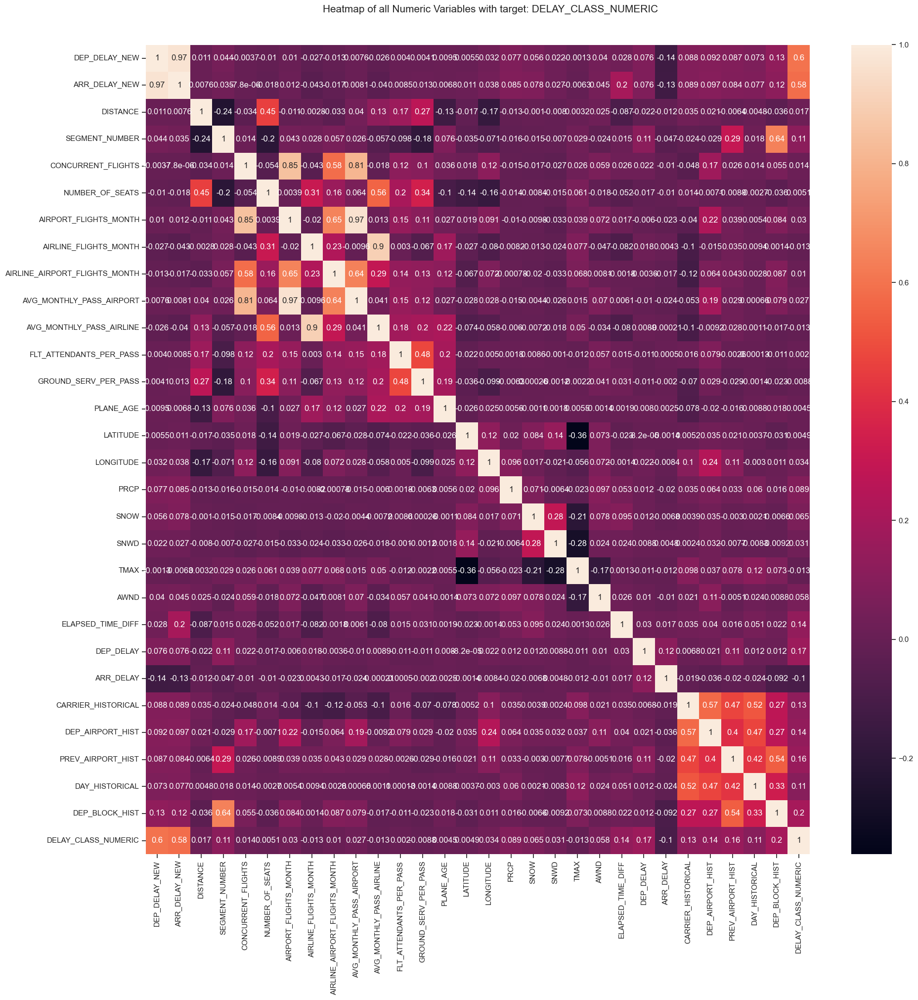

ValueError: Image size of 2000x90000 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 2000x90000 with 360 Axes>

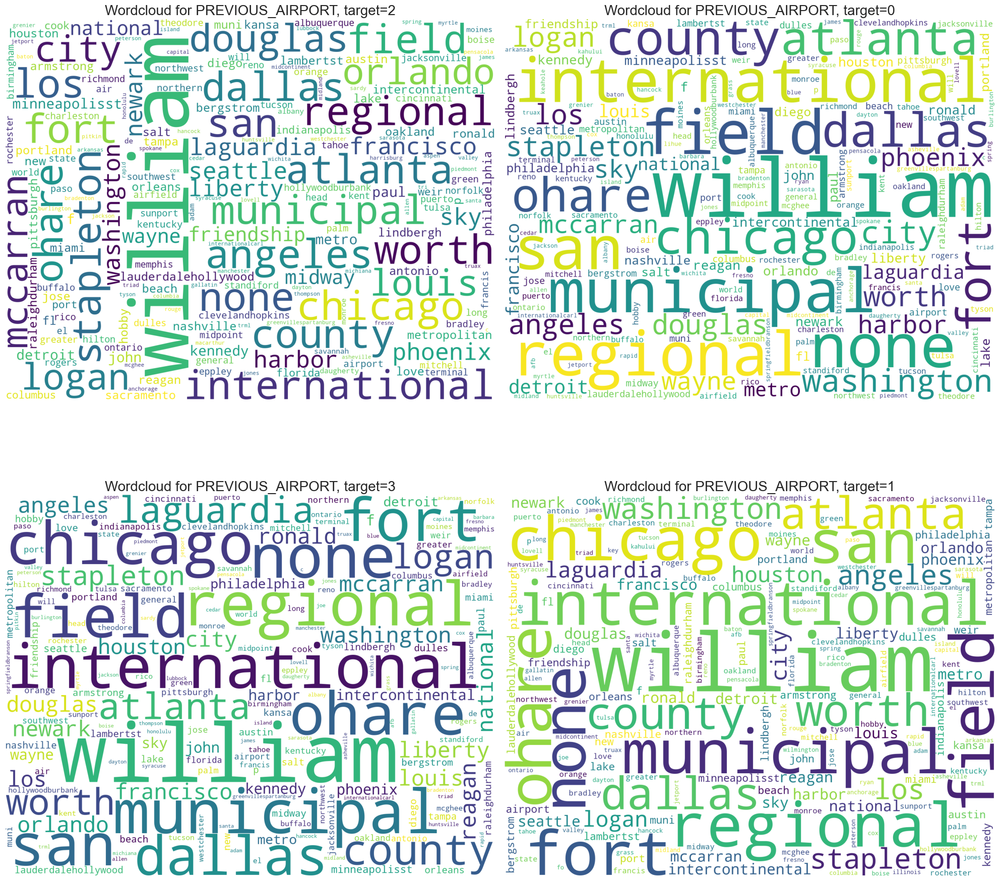

All Plots are saved in plots/autoviz_plots_train_data/DELAY_CLASS_NUMERIC
Time to run AutoViz = 37707 seconds 
Shape of your Data Set loaded: (1946719, 39)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
  Printing up to 30 columns (max) in each category:
    Numeric Columns : ['DEP_DELAY_NEW', 'ARR_DELAY_NEW', 'DISTANCE', 'GROUND_SERV_PER_PASS', 'LATITUDE', 'LONGITUDE', 'PRCP', 'SNOW', 'SNWD', 'TMAX', 'AWND', 'ELAPSED_TIME_DIFF', 'DEP_DELAY', 'ARR_DELAY', 'CARRIER_HISTORICAL', 'DEP_AIRPORT_HIST', 'PREV_AIRPORT_HIST', 'DAY_HISTORICAL', 'DEP_BLOCK_HIST', 'FLT_ATTENDANTS_PER_PASS']
    Integer-Categorical Columns: ['SEGMENT_NUMBER', 'CONCURRENT_FLIGHTS', 'NUMBER_OF_SEATS', 'AIRPORT_FLIGHTS_MONTH', 'AIRLINE_FLIGHTS_MONTH', 'AIRLINE_AIRPORT_

,Data Type,Missing Values%,Unique Values%,Minimum Value,Maximum Value,DQ Issue
MONTH,object,0.000000,0,,,No issue
DAY_OF_WEEK,object,0.000000,0,,,No issue
DEP_DELAY_NEW,float64,0.000000,NA,0.000000,2672.000000,Column has 334396 outliers greater than upper bound (17.50) or lower than lower bound(-10.50). Cap them or remove them.
ARR_DELAY_NEW,float64,0.000000,NA,0.000000,2649.000000,"Column has 308476 outliers greater than upper bound (20.00) or lower than lower bound(-12.00). Cap them or remove them., Column has a high correlation with ['DEP_DELAY_NEW']. Consider dropping one of them."
DISTANCE,float64,0.000000,NA,66.000000,5095.000000,Column has 121797 outliers greater than upper bound (2080.00) or lower than lower bound(-616.00). Cap them or remove them.
SEGMENT_NUMBER,int8,0.000000,0,1.000000,15.000000,Column has 30379 outliers greater than upper bound (7.00) or lower than lower bound(-1.00). Cap them or remove them.
CONCURRENT_FLIGHTS,int64,0.000000,0,1.000000,109.000000,Column has 45802 outliers greater than upper bound (81.00) or lower than lower bound(-31.00). Cap them or remove them.
NUMBER_OF_SEATS,int16,0.000000,0,44.000000,337.000000,Column has 802 outliers greater than upper bound (295.00) or lower than lower bound(-33.00). Cap them or remove them.
CARRIER_NAME,object,0.000000,0,,,1 rare categories: ['Allegiant Air']. Group them into a single category or drop the categories.
AIRPORT_FLIGHTS_MONTH,int64,0.000000,0,1100.000000,35256.000000,Column has a high correlation with ['CONCURRENT_FLIGHTS']. Consider dropping one of them.


Total Number of Scatter Plots = 210
Could not draw some Distribution Plots 'numpy.int8' object has no attribute 'startswith'


[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to
[nltk_data]    |     /Users/diptia/nltk_data...
[nltk_data]    |   Package cmudict is already up-to-date!
[nltk_data]    | Downloading package gazetteers to
[nltk_data]    |     /Users/diptia/nltk_data...
[nltk_data]    |   Package gazetteers is already up-to-date!
[nltk_data]    | Downloading package genesis to
[nltk_data]    |     /Users/diptia/nltk_data...
[nltk_data]    |   Package genesis is already up-to-date!
[nltk_data]    | Downloading package gutenberg to
[nltk_data]    |     /Users/diptia/nltk_data...
[nltk_data]    |   Package gutenberg is already up-to-date!
[nltk_data]    | Downloading package inaugural to
[nltk_data]    |     /Users/diptia/nltk_data...
[nltk_data]    |   Package inaugural is already up-to-date!
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]    |     /Users/diptia/nltk_data...
[nltk_data]    |   Package movie_reviews is already

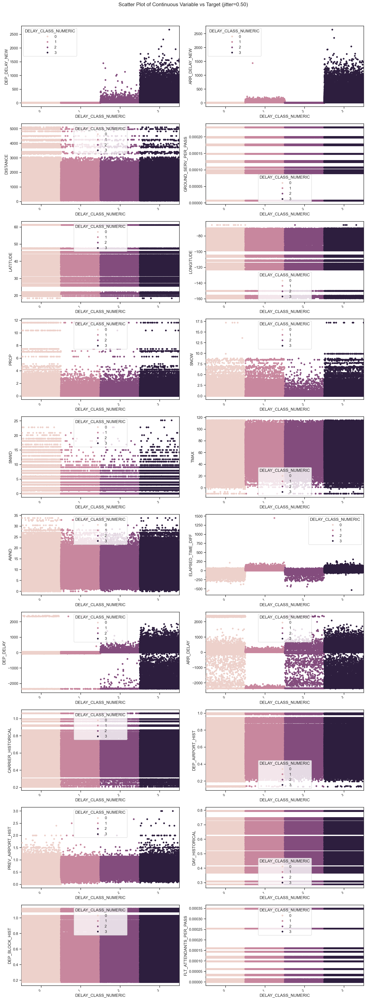

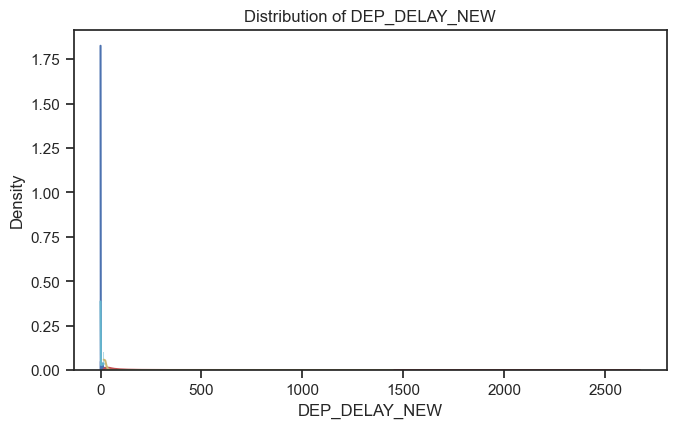

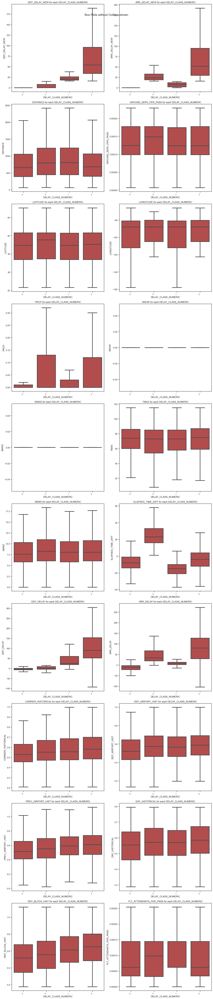

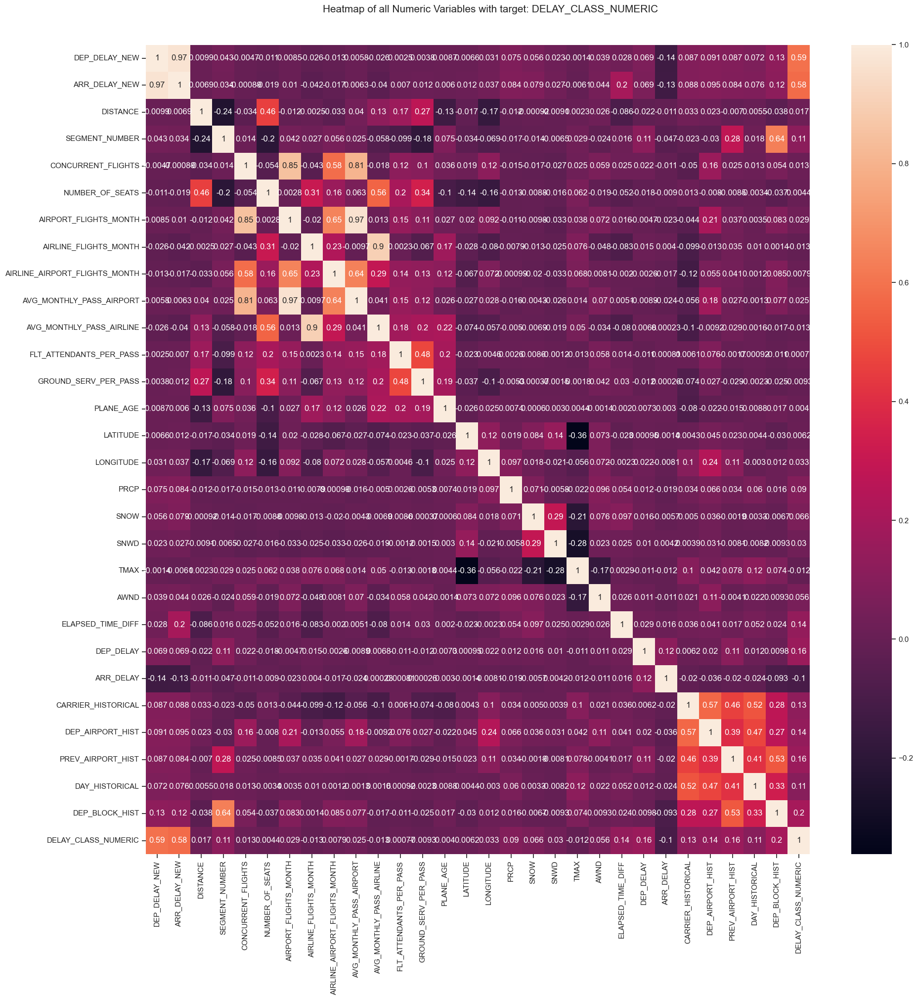

ValueError: Image size of 2000x90000 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 2000x90000 with 360 Axes>

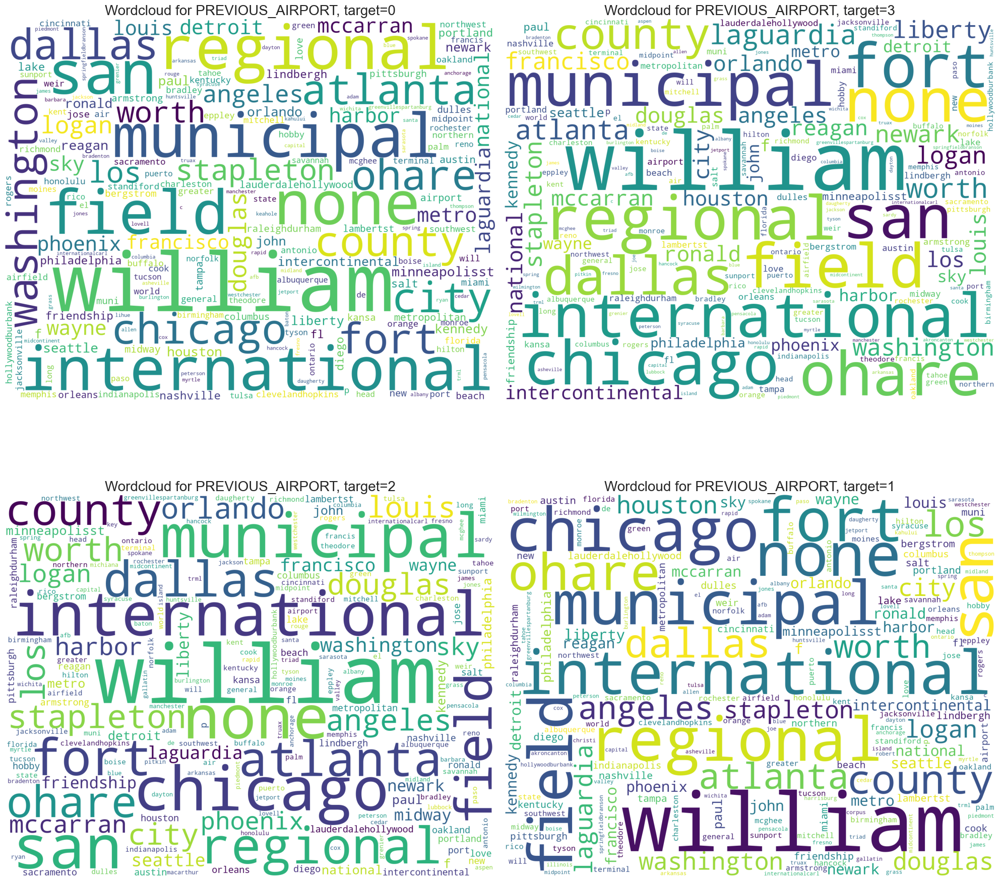

All Plots are saved in plots/autoviz_plots_test_data/DELAY_CLASS_NUMERIC
Time to run AutoViz = 17723 seconds 


In [68]:
#########################################################################################################
# Visualizing train data-set: with AutoViz library (credits: https://github.com/AutoViML/AutoViz)
#########################################################################################################
AV = AutoViz_Class()
plots_train_output = "../plots/autoviz_plots_train_data"
dft_new = AV.AutoViz(
    "",
    sep=",",
    depVar="DELAY_CLASS_NUMERIC",
    dfte=train,
    header=0,
    verbose=2,
    lowess=True,
    chart_format="svg",
    max_rows_analyzed=5000000,
    max_cols_analyzed=50,
    save_plot_dir=plots_train_output
)

#########################################################################################################
# Visualizing test data-set: with AutoViz library (credits: https://github.com/AutoViML/AutoViz)
#########################################################################################################
plots_test_output = "../plots/autoviz_plots_test_data"
dft_new = AV.AutoViz(
    "",
    sep=",",
    depVar="DELAY_CLASS_NUMERIC",
    dfte=test,
    header=0,
    verbose=2,
    lowess=True,
    chart_format="svg",
    max_rows_analyzed=2000000,
    max_cols_analyzed=50,
    save_plot_dir=plots_test_output
)


In [17]:
###############################################################################
# Cap outliers observed by AutoViz in Train and Test data
###############################################################################
def cap_outliers(df_cleaned, column, lower_bound, upper_bound):
    """
    Cap outliers in a specified column of input DataFrame to the given bounds.

    Parameters:
    - df: pandas DataFrame
    - column: str, name of the column to process
    - lower_bound: float, lower bound for capping
    - upper_bound: float, upper bound for capping

    Returns:
    - DataFrame with outliers capped
    """
    print(f"\nColumn {column} has outliers greater than upper bound ({upper_bound}) or lower than lower bound ({lower_bound}). Capping them now.")
    df_cleaned[column] = df_cleaned[column].clip(lower=lower_bound, upper=upper_bound)
    return df_cleaned

# Define bounds for each TRAIN DATA column where outliers are detected
dep_delay_new_bounds = (-10.50, 17.50)
arr_delay_new_bounds = (-12.00, 20.00)
distance_bounds = (-616.00, 2080.00)
segment_number_bounds = (-1.00, 7.00)
concurrent_flights_bounds = (-31.00, 81.00)
num_seats_bounds = (-33.00, 295.00)
airline_airport_flights_month_bounds = (-5574.00, 11034.00)
avg_monthly_pass_airport_bounds = (-1326960.00, 4006856.00)
flt_attendants_per_pass_bounds = (-0.00, 0.00)
latitude_bounds = (22.42, 51.79)
longitude_bounds = (-144.54, -42.77)
prcp_bounds = (-0.03, 0.05)
snow_bounds = (0.00, 0.00)
snwd_bounds = (0.00, 0.00)
tmax_bounds = (18.50, 126.50)
awnd_bounds = (-0.88, 16.99)
elapsed_time_diff_bounds = (-35.00, 21.00)
dep_delay_bounds = (-25.50, 26.50)
arr_delay_bounds = (-58.00, 46.00)
carrier_historical_bounds = (0.17, 0.93)
dep_airport_hist_bounds = (0.11, 1.05)
prev_airport_hist_bounds = (0.04, 1.05)

# Cap outliers on train data
train = cap_outliers(train, 'DEP_DELAY_NEW', *dep_delay_new_bounds)
train = cap_outliers(train, 'ARR_DELAY_NEW', *arr_delay_new_bounds)
train = cap_outliers(train, 'DISTANCE', *distance_bounds)
train = cap_outliers(train, 'SEGMENT_NUMBER', *segment_number_bounds)
train = cap_outliers(train, 'CONCURRENT_FLIGHTS', *concurrent_flights_bounds)
train = cap_outliers(train, 'NUMBER_OF_SEATS', *num_seats_bounds)
train = cap_outliers(train, 'AIRLINE_AIRPORT_FLIGHTS_MONTH', *airline_airport_flights_month_bounds)
train = cap_outliers(train, 'AVG_MONTHLY_PASS_AIRPORT', *avg_monthly_pass_airport_bounds)
train = cap_outliers(train, 'FLT_ATTENDANTS_PER_PASS', *flt_attendants_per_pass_bounds)
train = cap_outliers(train, 'LATITUDE', *latitude_bounds)
train = cap_outliers(train, 'LONGITUDE', *longitude_bounds)
train = cap_outliers(train, 'PRCP', *prcp_bounds)
train = cap_outliers(train, 'SNOW', *snow_bounds)
train = cap_outliers(train, 'SNWD', *snwd_bounds)
train = cap_outliers(train, 'TMAX', *tmax_bounds)
train = cap_outliers(train, 'AWND', *awnd_bounds)
train = cap_outliers(train, 'ELAPSED_TIME_DIFF', *elapsed_time_diff_bounds)
train = cap_outliers(train, 'DEP_DELAY', *dep_delay_bounds)
train = cap_outliers(train, 'ARR_DELAY', *arr_delay_bounds)
train = cap_outliers(train, 'CARRIER_HISTORICAL', *carrier_historical_bounds)
train = cap_outliers(train, 'DEP_AIRPORT_HIST', *dep_airport_hist_bounds)
train = cap_outliers(train, 'PREV_AIRPORT_HIST', *prev_airport_hist_bounds)


# Re-define bounds that change for some of the test data columns
airline_airport_flights_month_bounds = (-5571.50, 11032.50)
carrier_historical_bounds = (0.19, 0.92)
dep_airport_hist_bounds = (0.11, 0.99)
prev_airport_hist_bounds = (0.03, 1.05)


# Cap outliers on test data
test = cap_outliers(test, 'DEP_DELAY_NEW', *dep_delay_new_bounds)
test = cap_outliers(test, 'ARR_DELAY_NEW', *arr_delay_new_bounds)
test = cap_outliers(test, 'DISTANCE', *distance_bounds)
test = cap_outliers(test, 'SEGMENT_NUMBER', *segment_number_bounds)
test = cap_outliers(test, 'CONCURRENT_FLIGHTS', *concurrent_flights_bounds)
test = cap_outliers(test, 'NUMBER_OF_SEATS', *num_seats_bounds)
test = cap_outliers(test, 'AIRLINE_AIRPORT_FLIGHTS_MONTH', *airline_airport_flights_month_bounds)
test = cap_outliers(test, 'AVG_MONTHLY_PASS_AIRPORT', *avg_monthly_pass_airport_bounds)
test = cap_outliers(test, 'FLT_ATTENDANTS_PER_PASS', *flt_attendants_per_pass_bounds)
test = cap_outliers(test, 'LATITUDE', *latitude_bounds)
test = cap_outliers(test, 'LONGITUDE', *longitude_bounds)
test = cap_outliers(test, 'PRCP', *prcp_bounds)
test = cap_outliers(test, 'SNOW', *snow_bounds)
test = cap_outliers(test, 'SNWD', *snwd_bounds)
test = cap_outliers(test, 'TMAX', *tmax_bounds)
test = cap_outliers(test, 'AWND', *awnd_bounds)
test = cap_outliers(test, 'ELAPSED_TIME_DIFF', *elapsed_time_diff_bounds)
test = cap_outliers(test, 'DEP_DELAY', *dep_delay_bounds)
test = cap_outliers(test, 'ARR_DELAY', *arr_delay_bounds)
test = cap_outliers(test, 'CARRIER_HISTORICAL', *carrier_historical_bounds)
test = cap_outliers(test, 'DEP_AIRPORT_HIST', *dep_airport_hist_bounds)
test = cap_outliers(test, 'PREV_AIRPORT_HIST', *prev_airport_hist_bounds)


Column DEP_DELAY_NEW has outliers greater than upper bound (17.5) or lower than lower bound (-10.5). Capping them now.

Column ARR_DELAY_NEW has outliers greater than upper bound (20.0) or lower than lower bound (-12.0). Capping them now.

Column DISTANCE has outliers greater than upper bound (2080.0) or lower than lower bound (-616.0). Capping them now.

Column SEGMENT_NUMBER has outliers greater than upper bound (7.0) or lower than lower bound (-1.0). Capping them now.

Column CONCURRENT_FLIGHTS has outliers greater than upper bound (81.0) or lower than lower bound (-31.0). Capping them now.

Column NUMBER_OF_SEATS has outliers greater than upper bound (295.0) or lower than lower bound (-33.0). Capping them now.

Column AIRLINE_AIRPORT_FLIGHTS_MONTH has outliers greater than upper bound (11034.0) or lower than lower bound (-5574.0). Capping them now.

Column AVG_MONTHLY_PASS_AIRPORT has outliers greater than upper bound (4006856.0) or lower than lower bound (-1326960.0). Capping the

In [18]:
#########################################################################################################
# Are there variables highly correlated with each other? Use VIF to determine collinear variables in 
# addition to AutoViz's results
########################################################################################################
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Check for multi-collinear features in train data
train_copy = train.copy()

# Select non-object, non-category (numerical) columns
numerical_columns = train_copy.select_dtypes(exclude=['object', 'category']).columns

# Initialize StandardScaler
scaler = StandardScaler()

# Fit and transform only the numerical columns
train_copy[numerical_columns] = scaler.fit_transform(train_copy[numerical_columns])

# Function to calculate VIF for numeric variables
def calculate_vif(X):
    vif_data = pd.DataFrame()
    vif_data["feature"] = X.columns
    vif_data["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
    return vif_data

# Calculate VIF for numeric features in transformed data-frame
vif_data = calculate_vif(train_copy[numerical_columns])
print("Variance Inflation Factor (VIF):")
print(vif_data)

# Conclusion: Drop columns with high correlations: AIRPORT_FLIGHTS_MONTH (VIF = 24.15), AVG_MONTHLY_PASS_AIRLINE (VIF = 16.42), 
# DEP_DELAY_NEW  (VIF = 8.295170), ARR_DELAY_NEW  (VIF = 7.109672)
columns_to_drop = ['DEP_DELAY_NEW', 'ARR_DELAY_NEW', 
                           'AIRPORT_FLIGHTS_MONTH', 'AVG_MONTHLY_PASS_AIRLINE']
train_copy.drop(columns=columns_to_drop, inplace=True)

# Recalculate VIF for remaining columns
revif_data = calculate_vif(train_copy[numerical_columns.drop(columns_to_drop)])
print("Re-Variance Inflation Factor (VIF):")
print(revif_data)


# Now, drop these columns on Train and Test data-sets
train.drop(columns=columns_to_drop, inplace=True)
test.drop(columns=columns_to_drop, inplace=True)

Variance Inflation Factor (VIF):
              feature                 VIF   
0                   DEP_DELAY_NEW   8.295170
1                   ARR_DELAY_NEW   7.109672
2                        DISTANCE   1.445254
3                  SEGMENT_NUMBER   2.328285
4              CONCURRENT_FLIGHTS   3.861388
5                 NUMBER_OF_SEATS   2.942071
6           AIRPORT_FLIGHTS_MONTH  24.153913
7           AIRLINE_FLIGHTS_MONTH  12.530381
8   AIRLINE_AIRPORT_FLIGHTS_MONTH   2.096969
9        AVG_MONTHLY_PASS_AIRPORT  20.020862
10       AVG_MONTHLY_PASS_AIRLINE  16.418976
11        FLT_ATTENDANTS_PER_PASS        NaN
12           GROUND_SERV_PER_PASS   1.837997
13                      PLANE_AGE   1.268602
14                       LATITUDE   1.252083
15                      LONGITUDE   1.362439
16                           PRCP   1.085084
17                           SNOW        NaN
18                           SNWD        NaN
19                           TMAX   1.293011
20                    

In [19]:
###############################################################################
# Save train and test files to pickle and csv
###############################################################################
train.info()
test.info()

# save train files 
train.to_pickle("../combined_data/train.pkl")
train.to_csv('../combined_data/train.csv', index=False)

# save test files 
test.to_pickle("../combined_data/test.pkl")
test.to_csv('../combined_data/test.csv', index=False)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4542343 entries, 0 to 4542342
Data columns (total 35 columns):
 #   Column                         Dtype   
---  ------                         -----   
 0   MONTH                          object  
 1   DAY_OF_WEEK                    object  
 2   DISTANCE                       float64 
 3   SEGMENT_NUMBER                 int8    
 4   CONCURRENT_FLIGHTS             int64   
 5   NUMBER_OF_SEATS                int16   
 6   CARRIER_NAME                   object  
 7   AIRLINE_FLIGHTS_MONTH          int64   
 8   AIRLINE_AIRPORT_FLIGHTS_MONTH  int64   
 9   AVG_MONTHLY_PASS_AIRPORT       int64   
 10  FLT_ATTENDANTS_PER_PASS        float64 
 11  GROUND_SERV_PER_PASS           float64 
 12  PLANE_AGE                      int32   
 13  DEPARTING_AIRPORT              object  
 14  LATITUDE                       float64 
 15  LONGITUDE                      float64 
 16  PREVIOUS_AIRPORT               object  
 17  PRCP                       

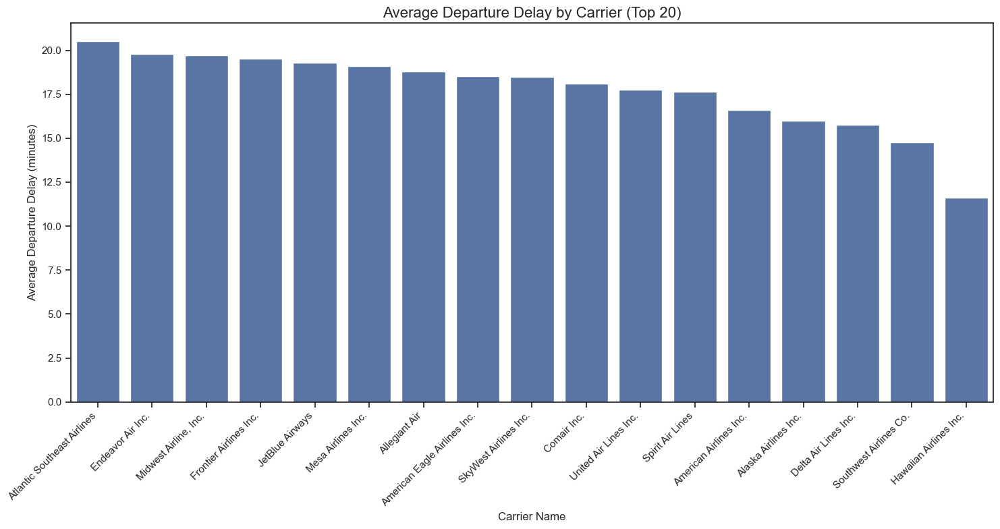

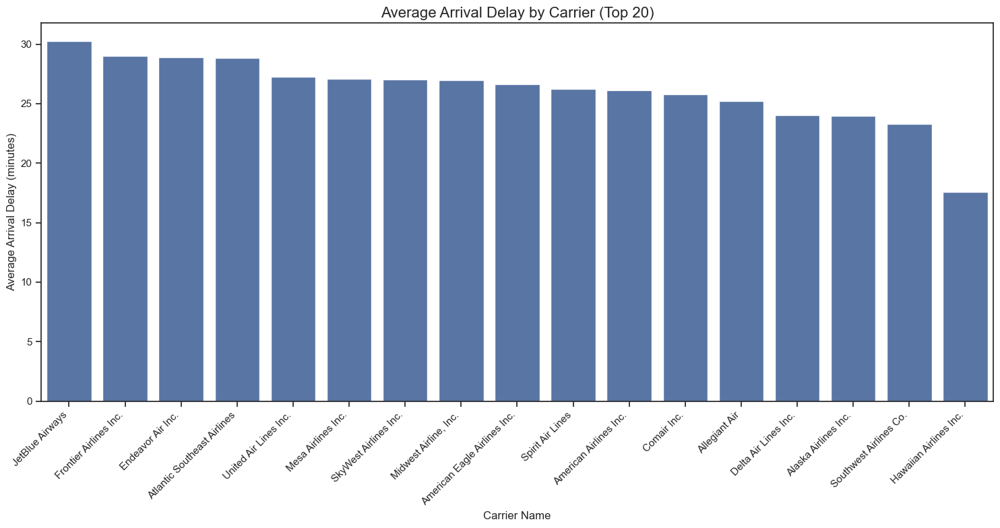

In [20]:
#############################################################################################################
# EDA - Plot average DEP_DELAY for each CARRIER_NAME
#############################################################################################################
avg_delay_by_carrier = train[train['DEP_DELAY'] > 0].groupby('CARRIER_NAME')['DEP_DELAY'].mean().sort_values(ascending=False)

# Select top 20 carriers
top_20_carriers = avg_delay_by_carrier.head(20)

# Create a bar plot
plt.figure(figsize=(15, 8))
sns.barplot(x=top_20_carriers.index, y=top_20_carriers.values)

# Customize the plot
plt.title('Average Departure Delay by Carrier (Top 20)', fontsize=16)
plt.xlabel('Carrier Name', fontsize=12)
plt.ylabel('Average Departure Delay (minutes)', fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Show the plot
plt.show()

#############################################################################################################
# EDA - Plot average ARR_DELAY for each CARRIER_NAME
#############################################################################################################
avg_arrival_by_carrier = train[train['ARR_DELAY'] > 0].groupby('CARRIER_NAME')['ARR_DELAY'].mean().sort_values(ascending=False)

# Select top 20 carriers
top_20_carriers = avg_arrival_by_carrier.head(20)

# Create a bar plot
plt.figure(figsize=(15, 8))
sns.barplot(x=top_20_carriers.index, y=top_20_carriers.values)

# Customize the plot
plt.title('Average Arrival Delay by Carrier (Top 20)', fontsize=16)
plt.xlabel('Carrier Name', fontsize=12)
plt.ylabel('Average Arrival Delay (minutes)', fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Show the plot
plt.show()

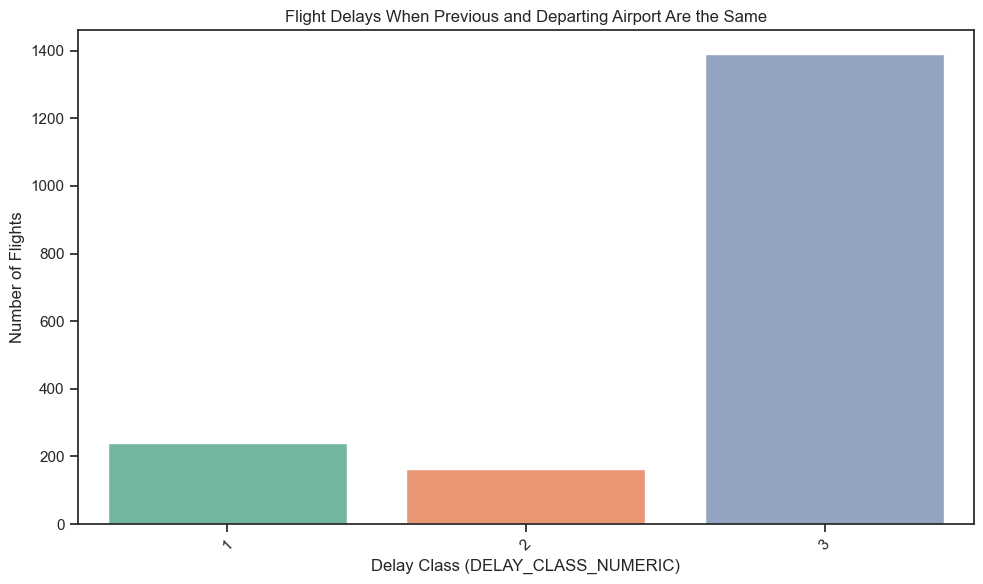

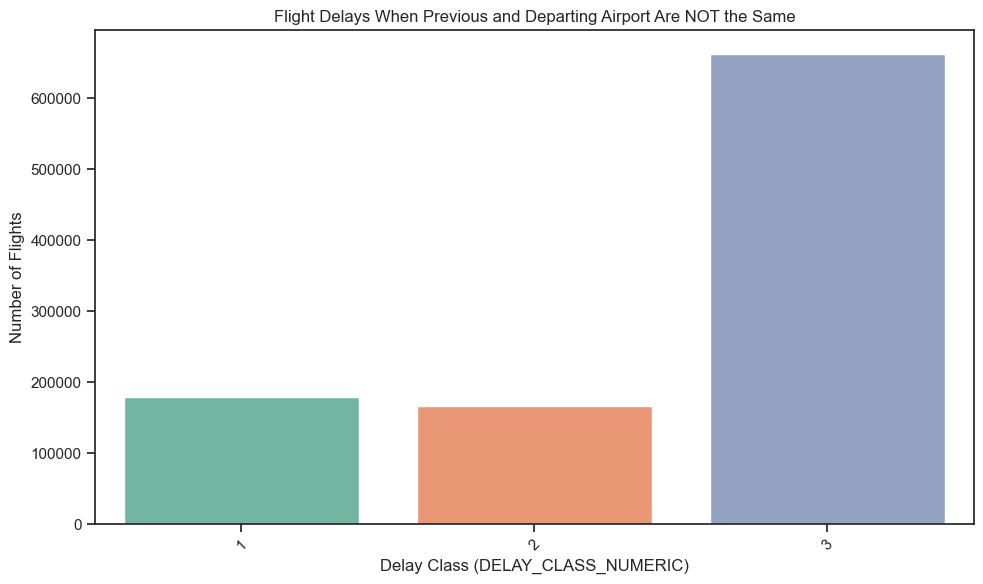

In [21]:
##############################################################################################################################################
# EDA - Plot delays that may exist when PREVIOUS AIRPORT and DEPARTING AIRPORT are and are not the same
# Conclusion - No pattern observed. Not conclusive enough.
##############################################################################################################################################
# Filter the dataset where PREVIOUS_AIRPORT and DEPARTING_AIRPORT are the same and there is a delay
filtered_df = train[(train['PREVIOUS_AIRPORT'] == train['DEPARTING_AIRPORT']) & (train['DELAY_CLASS_NUMERIC'] > 0)]

# Plotting
plt.figure(figsize=(10, 6))
sns.countplot(x='DELAY_CLASS_NUMERIC', data=filtered_df, palette='Set2')

plt.title('Flight Delays When Previous and Departing Airport Are the Same')
plt.xlabel('Delay Class (DELAY_CLASS_NUMERIC)')
plt.ylabel('Number of Flights')
plt.xticks(rotation=45)
plt.tight_layout()

plt.show()


# Filter the dataset where PREVIOUS_AIRPORT and DEPARTING_AIRPORT are NOT the same and there is a delay
filtered_df = train[(train['PREVIOUS_AIRPORT'] != train['DEPARTING_AIRPORT']) & (train['DELAY_CLASS_NUMERIC'] > 0)]

# Plotting
plt.figure(figsize=(10, 6))
sns.countplot(x='DELAY_CLASS_NUMERIC', data=filtered_df, palette='Set2')

plt.title('Flight Delays When Previous and Departing Airport Are NOT the Same')
plt.xlabel('Delay Class (DELAY_CLASS_NUMERIC)')
plt.ylabel('Number of Flights')
plt.xticks(rotation=45)
plt.tight_layout()

plt.show()

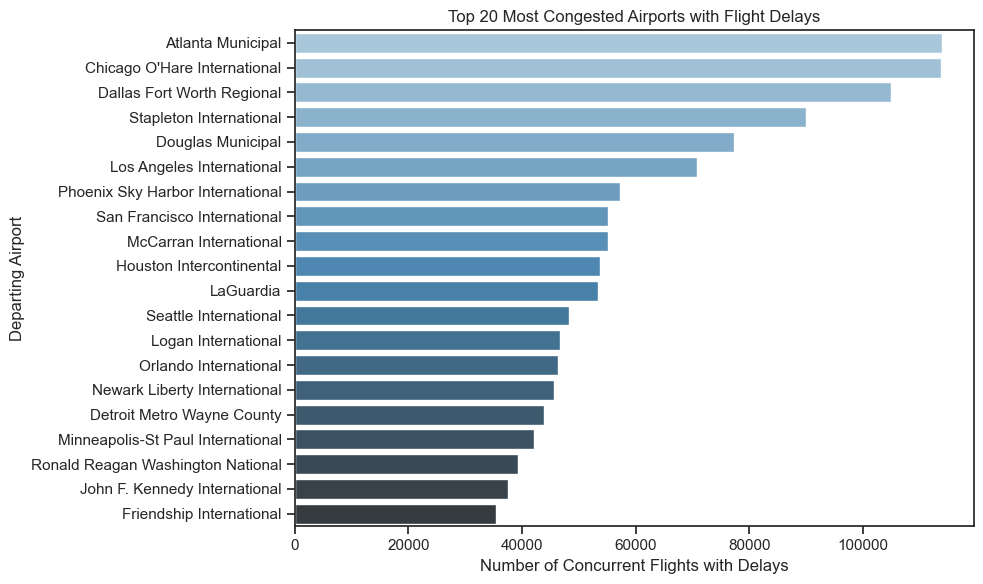

In [22]:
###############################################################################################################
# EDA - Plot the most congested airports(top 20) with flight delays
###############################################################################################################
# Filter for flights with delays, either arrival or departure delay
delayed_flights = train[(train['DEP_DELAY'] > 0) | (train['ARR_DELAY'] > 0)]

# Group by departing airport and count the number of delayed flights
congested_airports = delayed_flights.groupby('DEPARTING_AIRPORT')['CONCURRENT_FLIGHTS'].count().reset_index()

# Sort by the most congested airports
congested_airports = congested_airports.sort_values(by='CONCURRENT_FLIGHTS', ascending=False)

# Plot the most congested airports with delays
plt.figure(figsize=(10, 6))
sns.barplot(x='CONCURRENT_FLIGHTS', y='DEPARTING_AIRPORT', data=congested_airports.head(20), palette='Blues_d')
plt.title('Top 20 Most Congested Airports with Flight Delays')
plt.xlabel('Number of Concurrent Flights with Delays')
plt.ylabel('Departing Airport')
plt.tight_layout()
plt.show()



<Figure size 5000x8000 with 0 Axes>

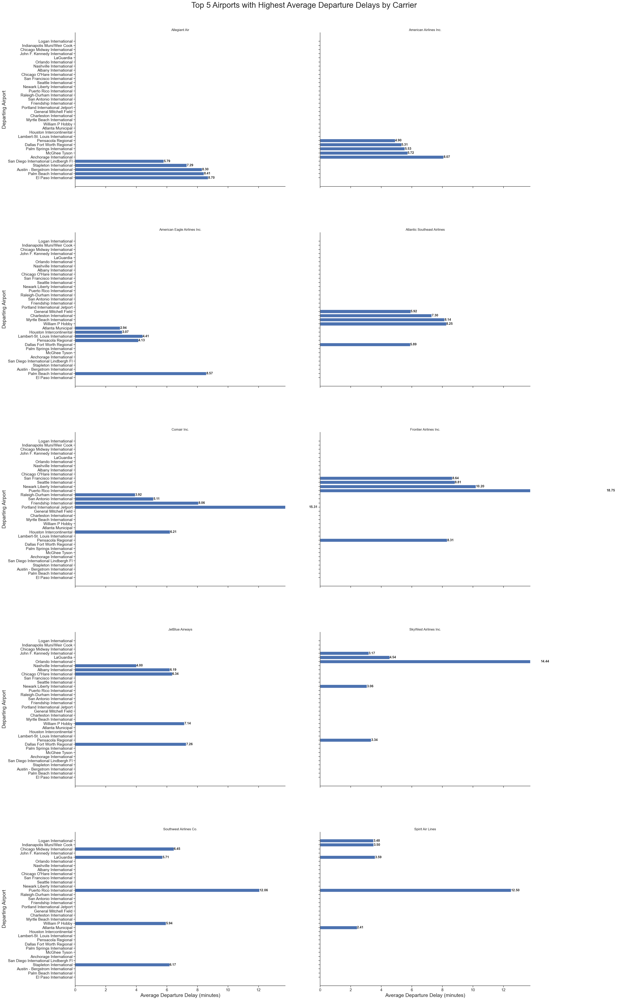

In [23]:
##############################################################################################################################################
# EDA - Plot average DEP_DELAY per Carrier/Airline (for top 10 Carriers) and Departing Airport (top 5 airports with delays for each carrier)
##############################################################################################################################################
# Calculate average DEP_DELAY per CARRIER_NAME and DEPARTING_AIRPORT
avg_delay = train.groupby(['CARRIER_NAME', 'DEPARTING_AIRPORT'])['DEP_DELAY'].mean().reset_index()

# Get top 10 carriers by total average delay
top_n_carriers = 10 
top_carriers = avg_delay.groupby('CARRIER_NAME')['DEP_DELAY'].mean().nlargest(top_n_carriers).index

# Function to get top 5 airports for each carrier
def get_top_5_airports(group):
    return group.nlargest(5, 'DEP_DELAY')

# Filter data for top carriers and top 5 airports per carrier
avg_delay_top = avg_delay[avg_delay['CARRIER_NAME'].isin(top_carriers)].groupby('CARRIER_NAME').apply(get_top_5_airports).reset_index(drop=True)

# Increase the figure size
plt.figure(figsize=(50, 80))

# Create the FacetGrid with larger subplot size
g = sns.FacetGrid(avg_delay_top, col='CARRIER_NAME', col_wrap=2, height=10, aspect=1.5)

# Map the horizontal barplot
def plot_horizontal_bars(x, y, **kwargs):
    ax = plt.gca()
    bars = ax.barh(y, x)
    ax.set_xlabel('Average Departure Delay (minutes)', fontsize=16)
    ax.set_ylabel('Departing Airport', fontsize=16)
    ax.tick_params(axis='both', which='major', labelsize=14)
    
    # Add value labels to the end of each bar
    for bar in bars:
        width = bar.get_width()
        ax.text(width, bar.get_y() + bar.get_height()/2, f'{width:.2f}', 
                ha='left', va='center', fontsize=12, fontweight='bold')
    
    # Adjust x-axis to add some padding
    ax.set_xlim(0, max(x) * 1.1)

g.map(plot_horizontal_bars, 'DEP_DELAY', 'DEPARTING_AIRPORT')

g.set_titles(col_template="{col_name}", fontsize=28)  
g.set_axis_labels("Average Departure Delay (minutes)", "Departing Airport", fontsize=18)

# Adjust the layout and display
plt.tight_layout()
plt.subplots_adjust(top=0.95, hspace=0.3) 

# Add a main title
plt.suptitle("Top 5 Airports with Highest Average Departure Delays by Carrier", fontsize=28)

# Save the figure with high resolution
plt.savefig('../images/carrier_airport_delays.png', dpi=900, bbox_inches='tight')

# Display the plot
plt.show()